# This requires a set of geospatial packages not included in ewatercycle


In [1]:
import glob
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import geopandas as gpd
from IPython.display import IFrame
import pandas as pd
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import sys
import os
import xarray as xr
from datetime import datetime
from pathlib import Path

In [2]:
path = Path.cwd()

figure_path = path / "Figures"
analysis_path = path.parent/ 'nbs_40_run_all_camels' / "Analysis" 

In [3]:
units= {"Imax":"mm",
        "Ce": "-",
        "Sumax": "mm",
        "Beta": "-",
        "Pmax": "mm",
        "Tlag": "d",
        "Kf": "-",
        "Ks": "-",
        "FM":'mm/d/degC',
        "Si": "mm",
        "Su": "mm",
        "Sf": "mm",
        "Ss": "mm",
        "Sp": "mm",
        "Ei_dt": "mm/d",
        "Ea_dt": "mm/d",
        "Qs_dt": "mm/d",
        "Qf_dt": "mm/d",
        "Q_tot_dt": "mm/d",
        "Q": "mm/d"}

p_names = ["$I_{max}$",  "$C_e$",  "$Su_{max}$", "β",  "$P_{max}$",  "$T_{lag}$",   "$K_f$",   "$K_s$", "FM"]
S_names = ["Interception storage", "Unsaturated Rootzone Storage", "Fastflow storage", "Groundwater storage", "Snowpack storage"]
names = p_names + S_names
param_names = ["Imax","Ce",  "Sumax", "Beta",  "Pmax",  "Tlag",   "Kf",   "Ks", "FM"]
stor_names = ["Si", "Su", "Sf", "Ss", "Sp"]

var_names =  {x: names[i] for i, x in enumerate(param_names + stor_names)}

## load characteristic files

In [4]:
geospatial_files = analysis_path / "camels_characteristics" 

In [5]:
lst_paths_characteristic = list(geospatial_files.glob('*.feather'))

In [6]:
lst_char_df = []
for path in lst_paths_characteristic:
    df = pd.read_feather(path).set_index('gauge_id')
    df.index.name = "HRU_id"
    lst_char_df.append(df)

In [7]:
[path.name for path in lst_paths_characteristic]

['catchment_names.feather',
 'clim_indicators.feather',
 'geol_indicators.feather',
 'hydro_indicators.feather',
 'soil_indicators.feather',
 'topo_indicators.feather',
 'vege_indicators.feather']

In [8]:
df_char_names = lst_char_df[0]
df_char_names.head(3)

,huc_02,gauge_name
HRU_id,,
1013500,1,"Fish River near Fort Kent, Maine"
1022500,1,"Narraguagus River at Cherryfield, Maine"
1030500,1,"Mattawamkeag River near Mattawamkeag, Maine"


In [9]:
df_char_clim = lst_char_df[1]
df_char_clim.head(3)

,p_mean,pet_mean,p_seasonality,frac_snow,aridity,high_prec_freq,high_prec_dur,high_prec_timing,low_prec_freq,low_prec_dur,low_prec_timing
HRU_id,,,,,,,,,,,
1013500,3.126679,1.971555,0.187940,0.313440,0.630559,12.95,1.348958,son,202.20,3.427119,mam
1022500,3.608126,2.119256,-0.114530,0.245259,0.587356,20.55,1.205279,son,233.65,3.662226,jja
1030500,3.274405,2.043594,0.047358,0.277018,0.624111,17.15,1.207746,son,215.60,3.514262,djf


In [10]:
df_char_geol = lst_char_df[2]
df_char_geol.head(3)

,geol_1st_class,glim_1st_class_frac,geol_2nd_class,glim_2nd_class_frac,carbonate_rocks_frac,geol_porostiy,geol_permeability
HRU_id,,,,,,,
1013500,Siliciclastic sedimentary rocks,0.815904,Basic volcanic rocks,0.179729,0.00000,0.1714,-14.7019
1022500,Acid plutonic rocks,0.590658,Siliciclastic sedimentary rocks,0.164618,0.00000,0.0710,-14.2138
1030500,Siliciclastic sedimentary rocks,0.573305,Metamorphics,0.287010,0.05214,0.1178,-14.4918


In [11]:
df_char_hydro= lst_char_df[3]
df_char_hydro.head(3)

,q_mean,runoff_ratio,slope_fdc,baseflow_index,stream_elas,q5,q95,high_q_freq,high_q_dur,low_q_freq,low_q_dur,zero_q_freq,hfd_mean
HRU_id,,,,,,,,,,,,,
1013500,1.699155,0.543437,1.528219,0.585226,1.845324,0.241106,6.373021,6.10,8.714286,41.35,20.170732,0.0,207.25
1022500,2.173062,0.602269,1.776280,0.554478,1.702782,0.204734,7.123049,3.90,2.294118,65.15,17.144737,0.0,166.25
1030500,1.820108,0.555859,1.871110,0.508441,1.377505,0.107149,6.854887,12.25,7.205882,89.25,19.402174,0.0,184.90


In [12]:
df_char_soil = lst_char_df[4]
df_char_soil.head(3)

,soil_depth_pelletier,soil_depth_statsgo,soil_porosity,soil_conductivity,max_water_content,sand_frac,silt_frac,clay_frac,water_frac,organic_frac,other_frac
HRU_id,,,,,,,,,,,
1013500,7.404762,1.248408,0.461149,1.106522,0.558055,27.841827,55.156940,16.275732,5.376698,0.408717,0.000000
1022500,17.412808,1.491846,0.415905,2.375005,0.626229,59.390156,28.080937,12.037646,1.226913,0.000000,0.358472
1030500,19.011414,1.461363,0.459091,1.289807,0.653020,32.235458,51.779182,14.776824,1.634345,1.330278,0.022016


In [13]:
df_char_topo = lst_char_df[5]
df_char_topo.head(3)

,gauge_lat,gauge_lon,elev_mean,slope_mean,area_gages2,area_geospa_fabric
HRU_id,,,,,,
1013500,47.23739,-68.58264,250.31,21.64152,2252.70,2303.95
1022500,44.60797,-67.93524,92.68,17.79072,573.60,620.38
1030500,45.50097,-68.30596,143.80,12.79195,3676.17,3676.09


In [14]:
df_char_vege = lst_char_df[6]
df_char_vege.head(3)

,frac_forest,lai_max,lai_diff,gvf_max,gvf_diff,dom_land_cover_frac,dom_land_cover,root_depth_50,root_depth_99
HRU_id,,,,,,,,,
1013500,0.9063,4.167304,3.340732,0.804567,0.371648,0.883452,Mixed Forests,NaN,NaN
1022500,0.9232,4.871392,3.746692,0.863936,0.337712,0.820493,Mixed Forests,0.237435,2.238444
1030500,0.8782,4.685200,3.665543,0.858502,0.351393,0.975258,Mixed Forests,NaN,NaN


In [15]:
gdf_catchments = gpd.read_file(geospatial_files / "catchments.gpkg")
gdf_catchments = gdf_catchments[['hru_id','geometry']]
gdf_catchments = gdf_catchments.set_index('hru_id')
gdf_catchments.index.name = "HRU_id"

<Axes: >

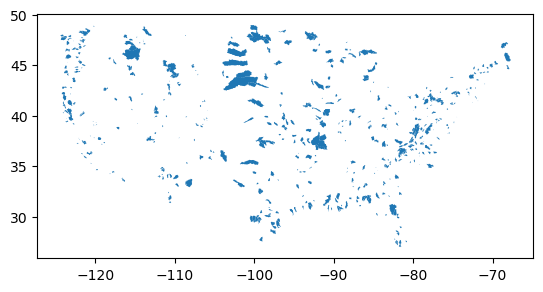

In [16]:
gdf_catchments.plot()

In [17]:
gdf_gauges = gpd.read_file(geospatial_files / "gauges.gpkg")
gdf_gauges = gdf_gauges.set_index('gauge_id')
gdf_gauges.index.name = "HRU_id"
gdf_gauges

,gauge_lat,gauge_lon,elev_mean,slope_mean,area_gages2,area_geospa_fabric,geometry
HRU_id,,,,,,,
1013500,47.23739,-68.58264,250.31,21.64152,2252.70,2303.95,POINT (-68.58264 47.23739)
1022500,44.60797,-67.93524,92.68,17.79072,573.60,620.38,POINT (-67.93524 44.60797)
1030500,45.50097,-68.30596,143.80,12.79195,3676.17,3676.09,POINT (-68.30596 45.50097)
1031500,45.17501,-69.31470,247.80,29.56035,769.05,766.53,POINT (-69.31470 45.17501)
1047000,44.86920,-69.95510,310.38,49.92122,909.10,904.94,POINT (-69.95510 44.86920)
...,...,...,...,...,...,...,...
14309500,42.80400,-123.61091,709.83,110.42527,224.92,226.31,POINT (-123.61091 42.80400)
14316700,43.34984,-122.72894,952.26,119.08920,587.90,588.01,POINT (-122.72894 43.34984)
14325000,42.89150,-124.07065,656.53,124.96889,443.07,444.92,POINT (-124.07065 42.89150)


In [18]:
hru_id_cal = ['01137500',
            '01139800',
            '01187300',
            '01052500',
            '01073000',
            '01181000',
            '01169000',
            '01013500',
            '01123000',
            '01055000',
            '01047000',
            '04296000',
            '01022500',
            '01134500',
            '01170100',
            '01142500',
            '01144000',
            '01054200',
            '01031500',
            '01139000',
            '01057000',
            '01078000',
            '01162500',
            '01030500',
            '01118300',
            '01121000']
for index, ids in enumerate(hru_id_cal):
    hru_id_cal[index] = int(ids)
gdf_callibration_catchment = gdf_catchments.loc[hru_id_cal]
gdf_callibration_gauges = gdf_gauges.loc[hru_id_cal]

### plotting to check 

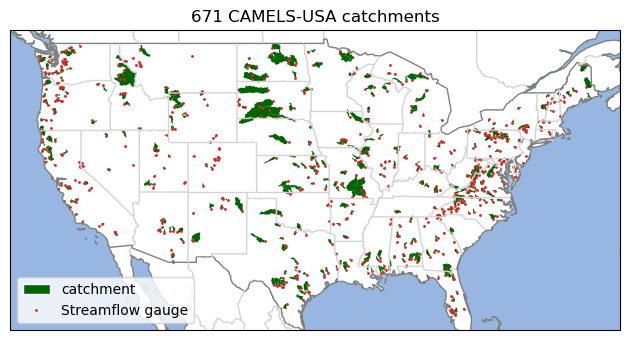

In [19]:
# set up background maps
ax = plt.axes(projection=ccrs.PlateCarree())
country_borders = cfeature.NaturalEarthFeature(
    category='cultural',
    name='admin_0_boundary_lines_land',
    scale='10m',
    facecolor='none')
ax.add_feature(country_borders, edgecolor='gray')

state_borders = cfeature.NaturalEarthFeature(
    category='cultural',
    name='admin_1_states_provinces_lines',
    scale='10m',
    facecolor='none')
ax.add_feature(state_borders, edgecolor='lightgray')
ax.add_feature(cfeature.COASTLINE, edgecolor='gray')
ax.add_feature(cfeature.OCEAN, edgecolor='lightblue')

# add legend properties
ms = 1
color = "C3"
catchment_color = "darkgreen"
gdf_catchments.plot(ax=ax,facecolor=catchment_color)
gdf_gauges.plot(ax=ax,markersize=ms,color=color)

ax.set_title(f"{len(gdf_catchments)} CAMELS-USA catchments")
# add legend
legend_gauges = matplotlib.lines.Line2D([],[],color=color,markersize=ms,marker="o",linewidth=0,label='Streamflow gauge')
legend_catchments = matplotlib.patches.Patch(facecolor=catchment_color, edgecolor='w',label=f"catchment")
ax.legend(loc='best', handles=ax.get_legend_handles_labels()[0] + [legend_catchments,legend_gauges])
          
plt.tight_layout()
# plt.savefig(fr'{figures_path}\CAMELS-USA-catchments-with_gauges.png',bbox_inches="tight")

### select one 

In [20]:
3604000     

3604000

## load results

In [21]:
df_res_all = pd.read_feather("DA_vs_calibrated.feather")
df_res_all_incl_dropped = pd.read_feather("DA_vs_calibrated_all.feather")

In [22]:
df_res_all = pd.read_feather("DA_vs_calibrated.feather")
df_res_all.index = [int(index) for index in df_res_all.index]

In [23]:
df_res_all.head(3)

,NSE_cal,log_NSE_cal,cal_Imax,cal_Ce,cal_Sumax,cal_Beta,cal_Pmax,cal_Tlag,cal_Kf,cal_Ks,...,NSE_mean_DA,log_NSE_mean_DA,NSE_best_DA,log_NSE_best_DA,Q_spread,DA_sse,NSE_delta_mean,NSE_delta_best,log_NSE_delta_mean,log_NSE_delta_best
6154410,0.230414,-0.050829,1.663776,0.430452,584.195784,2.666623,0.250860,1.0,0.041190,0.005846,...,-0.756368,-3.405869,0.985844,0.722735,11.523916,995.523190,-0.986782,0.755430,-3.355040,0.773564
1606500,0.573991,0.794219,7.154228,0.429663,92.863537,2.399659,0.017317,1.0,0.093157,0.008725,...,0.449110,0.377008,0.798673,0.821851,1.272507,7894.964636,-0.124882,0.224681,-0.417211,0.027631
14138900,0.500492,0.510117,2.530952,0.609753,661.988854,0.672375,0.097295,1.0,0.092623,0.004903,...,0.497558,0.229429,0.506769,0.266935,0.041932,303291.064979,-0.002933,0.006277,-0.280688,-0.243182


In [24]:
def plot_cal_vs_Qspread_1(df,c_var, show_cal=False):
    df.index = [int(index) for index in df.index]
    fig, ax = plt.subplots(1,1,figsize=(6,4))
    df_plot = df[(df['NSE_delta_best']<1) & (df['NSE_delta_best']>-2)].copy()
    df_plot.plot.scatter(c_var,'NSE_delta_best',c="C0",ax=ax,alpha=0.75,label=f'n={len(df_plot)}')
    if show_cal:
        hru_id_cal_in_results = list(set(df.index).intersection(hru_id_cal))
        print(len(hru_id_cal_in_results))
        df_cal = df.loc[hru_id_cal_in_results]
        df_cal.plot.scatter(c_var, 'NSE_delta_best', ax=ax, zorder=10, label='Cal',s=5, color='C3',marker='.')
        
    # ax.set_xlabel("NSE from calibration")
    ax.set_ylabel("$\Delta$NSE ")
    ax.set_title(f'$\Delta$NSE vs {c_var}')
    
    return fig, ax

25


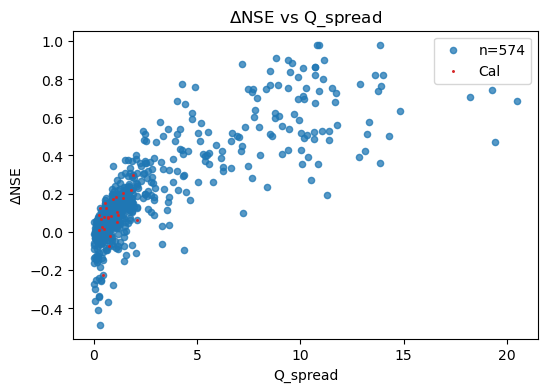

In [25]:
var = 'Q_spread'
fig, ax = plot_cal_vs_Qspread_1(df_res_all, var, True)
# ax.axvline(2.5,color='k',zorder=-1,ls="--");
fig.savefig(figure_path / f'NSE_delta_vs_{var}.png',bbox_inches='tight',dpi=150)

In [26]:
# df_res_all_incl_dropped_hydro = df_res_all_incl_dropped.copy()
# for col in df_char_hydro.columns:
#     df_res_all_incl_dropped_hydro[col] = df_res_all_incl_dropped_hydro.apply(lambda x: df_char_hydro.loc[int(x.name),col] 
#                                                           if int(x.name) in df_char_hydro.index
#                                                           else np.nan, 
#                                                           axis=1)
    

In [27]:
# var = 'q_mean'
# fig, ax = plot_cal_vs_Qspread_1(df_res_all_incl_dropped_hydro, var, True)
# # ax.axvline(2.5,color='k');
# fig.savefig(figure_path / f'NSE_delta_vs_{var}.png',bbox_inches='tight',dpi=150)

In [29]:
def plot_cal_vs_Qspread_2(df,c_var, show_cal=False):
    fig, ax = plt.subplots(1,1,figsize=(6,4))
    df.plot.scatter('NSE_cal','NSE_best_DA',c=df[c_var].values,ax=ax,colormap='viridis_r',alpha=0.75)
    ax.set_xlabel("NSE from calibration")
    ax.set_ylabel("NSE of best ensemble member from DA")
    ax.set_xlim(0,1)
    ax.set_ylim(0,1)
    ax.plot([[0,0],[1,1]],color="k",ls="--")
    ax.set_title(f'NSE of calibration vs NSE of data assimilation\nCharacteristic: {c_var}')

    if show_cal:
        hru_id_cal_in_results = list(set(df.index).intersection(hru_id_cal))
        df_cal = df.loc[hru_id_cal_in_results]
        df_cal.plot.scatter('NSE_cal', 'NSE_best_DA', ax=ax, zorder=10, label='Cal',s=5, color='C3',marker='.')
    
    return fig, ax

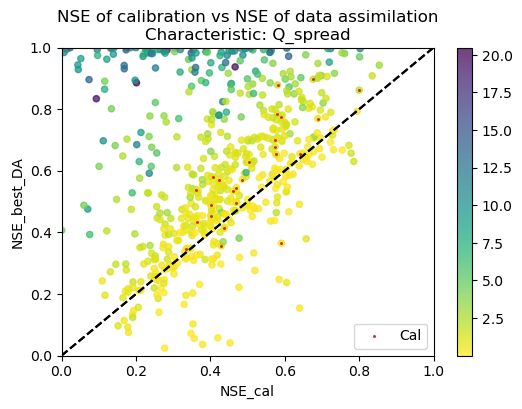

In [30]:
var = 'Q_spread'
fig , ax = plot_cal_vs_Qspread_2(df_res_all, var, True)
# fig.savefig(figure_path / f'NSE_cal_vs_NSE_best_{var}.png',bbox_inches='tight',dpi=150)

<Axes: title={'center': 'NSE of calibration vs NSE of data assimilation\nCharacteristic: Q_spread'}, xlabel='NSE_cal', ylabel='NSE_best_DA'>

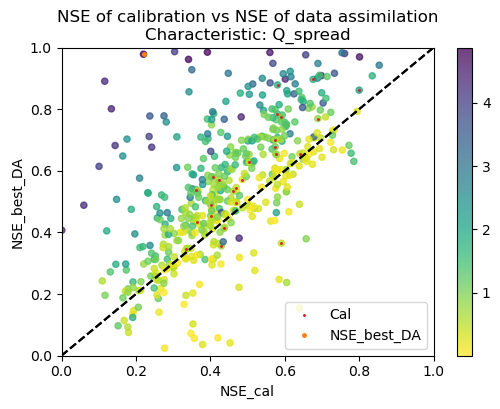

In [31]:
var = 'Q_spread'
fig, ax = plot_cal_vs_Qspread_2(df_res_all[df_res_all[var] < 5.0], var, True)
df_res_all.loc[[4122500]].plot('NSE_cal','NSE_best_DA',color='C1', ax=ax,marker='.',lw=0,ms=5)
# fig.savefig(figure_path / f'NSE_cal_vs_NSE_best_{var}.png',bbox_inches='tight',dpi=150)

In [32]:
# df_res_all[df_res_all[var] < 5.0].sort_values('Q_spread',ascending=False).head(3)

## make maps

In [33]:
gdf_catchments_nse = gdf_catchments.copy()

In [34]:
for col in df_res_all.columns:
    gdf_catchments_nse[col] = gdf_catchments_nse.apply(lambda x: df_res_all.loc[int(x.name),col] 
                                                          if x.name in df_res_all.index and df_res_all.loc[int(x.name),col] > 0
                                                          else np.nan, 
                                                          axis=1)
# gdf_catchments_nse['NSE_mean_log'] = gdf_catchments_nse.apply(lambda x: df_res_all.loc[int(x.name),"NSE_mean_log"] 
#                                                               if x.name in df_res_all.index 
#                                                               else np.nan, 
#                                                               axis=1)

In [35]:
df_res_all.columns

Index(['NSE_cal', 'log_NSE_cal', 'cal_Imax', 'cal_Ce', 'cal_Sumax', 'cal_Beta',
       'cal_Pmax', 'cal_Tlag', 'cal_Kf', 'cal_Ks', 'cal_FM', 'cal_sse',
       'NSE_mean_DA', 'log_NSE_mean_DA', 'NSE_best_DA', 'log_NSE_best_DA',
       'Q_spread', 'DA_sse', 'NSE_delta_mean', 'NSE_delta_best',
       'log_NSE_delta_mean', 'log_NSE_delta_best'],
      dtype='object')

In [36]:
# gdf_catchments_nse.head(10)

In [37]:
# set up background maps
def plot_map(gdf_plot, col,save=False): 
    plt.figure(figsize=(12,5))
    ax = plt.axes(projection=ccrs.PlateCarree())
    country_borders = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_0_boundary_lines_land',
        scale='10m',
        facecolor='none')
    ax.add_feature(country_borders, edgecolor='gray')
    
    state_borders = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='10m',
        facecolor='none')
    ax.add_feature(state_borders, edgecolor='lightgray')
    ax.add_feature(cfeature.COASTLINE, edgecolor='gray')
    ax.add_feature(cfeature.OCEAN, edgecolor='lightblue')
    
    # col = "NSE_mean_log"
    custom_cmap = "viridis"
    gdf_plot.plot(ax=ax,column=col, cmap=custom_cmap, legend=True,)
                        # legend_kwds={"loc": "center left", "bbox_to_anchor": (1, .7)})
    
    callibration_kwargs = dict(facecolor="white", edgecolor="C3",lw=0.5,zorder=-1)
    gdf_callibration_catchment.plot(ax=ax, **callibration_kwargs)
    
    catchment_kwargs = dict(facecolor="white", edgecolor="k",lw=0.1,zorder=-2)
    gdf_catchments.plot(ax=ax, **catchment_kwargs)
    
    
    # add legend
    legend_cal = matplotlib.patches.Patch(**callibration_kwargs,label=f"callibration")
    legend_catchments = matplotlib.patches.Patch(**catchment_kwargs,label=f"tested catchments")
    ax.legend(loc='lower right', handles=ax.get_legend_handles_labels()[0] + [legend_cal,legend_catchments])

    dict_col = {'NSE_delta_best': "$\Delta$NSE",
                'log_NSE_delta_best': "$\Delta$log(NSE)"}
    if col in dict_col:
        col = dict_col[col]
    title = f"{col} for the {len(gdf_plot)} CAMELS-USA catchments"
    ax.set_title(title)
              
    plt.tight_layout()
    title = title.replace(' ','_').replace('$','').replace('\\','')
    if save:
        plt.savefig(figure_path / (title + '.png'),bbox_inches="tight",dpi=100)
    
    USA_extent = ax.get_extent()
    return ax

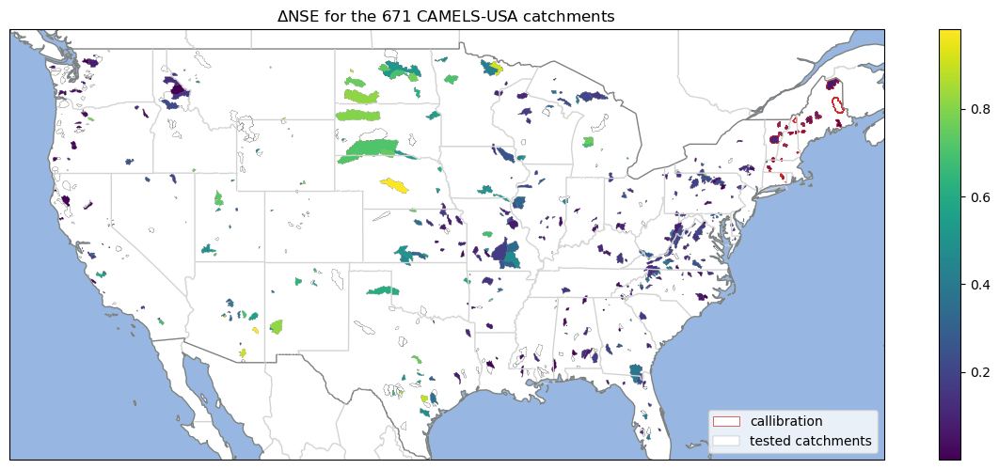

In [38]:
ax = plot_map(gdf_catchments_nse, "NSE_delta_best", save=True)

<GeoAxes: title={'center': '$\\Delta$log(NSE) for the 671 CAMELS-USA catchments'}>

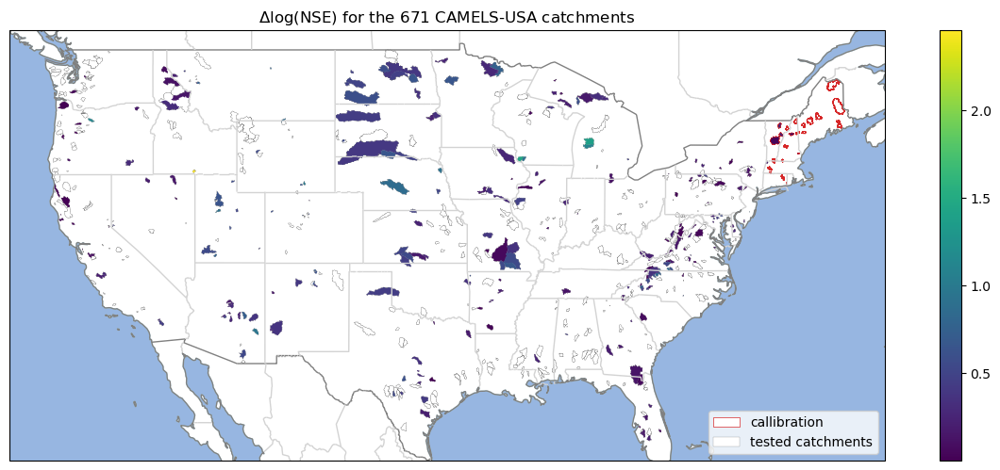

In [39]:
plot_map(gdf_catchments_nse, "log_NSE_delta_best")

<GeoAxes: title={'center': 'NSE_delta_mean for the 671 CAMELS-USA catchments'}>

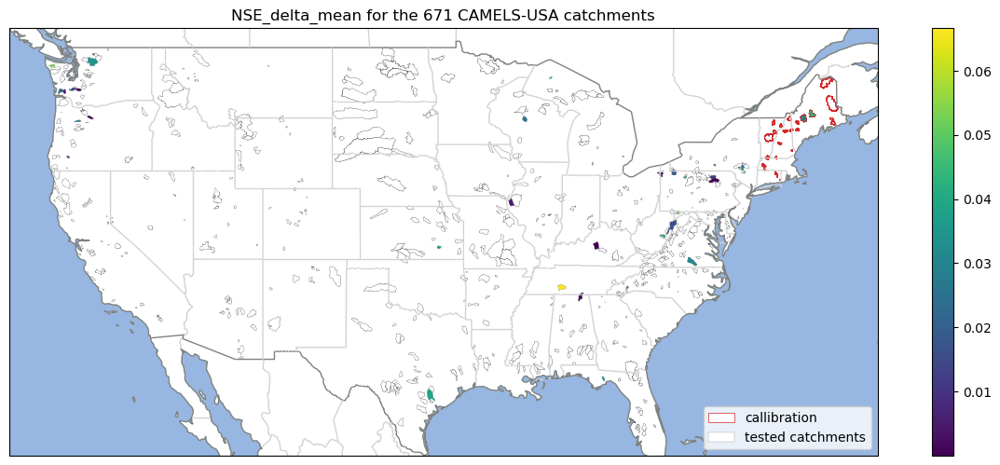

In [40]:
plot_map(gdf_catchments_nse, "NSE_delta_mean")

In [41]:
gdf_catchments_nse.head(3)

,geometry,NSE_cal,log_NSE_cal,cal_Imax,cal_Ce,cal_Sumax,cal_Beta,cal_Pmax,cal_Tlag,cal_Kf,...,NSE_mean_DA,log_NSE_mean_DA,NSE_best_DA,log_NSE_best_DA,Q_spread,DA_sse,NSE_delta_mean,NSE_delta_best,log_NSE_delta_mean,log_NSE_delta_best
HRU_id,,,,,,,,,,,,,,,,,,,,,
1013500,"MULTIPOLYGON (((-68.35650 46.90311, -68.35612 ...",0.800059,0.771308,4.749672,0.593942,329.779842,2.868787,0.273734,10.0,0.082978,...,0.578130,NaN,0.861828,0.662818,2.104850,8981.288248,NaN,0.061770,NaN,NaN
1022500,"POLYGON ((-67.97836 44.61310, -67.97800 44.613...",0.640479,0.790192,3.821724,0.525450,505.139245,2.059477,0.187887,2.0,0.097691,...,0.521113,0.541622,0.655206,0.706836,0.488813,16904.200687,NaN,0.014728,NaN,NaN
1030500,"MULTIPOLYGON (((-67.83991 45.36614, -67.83955 ...",0.437132,0.631559,4.218451,0.243444,473.511422,0.739878,0.126805,4.0,0.042314,...,0.150020,0.319357,0.412902,0.476651,0.776405,13046.231415,NaN,NaN,NaN,NaN


In [42]:
gdf_catchments_nse.columns

Index(['geometry', 'NSE_cal', 'log_NSE_cal', 'cal_Imax', 'cal_Ce', 'cal_Sumax',
       'cal_Beta', 'cal_Pmax', 'cal_Tlag', 'cal_Kf', 'cal_Ks', 'cal_FM',
       'cal_sse', 'NSE_mean_DA', 'log_NSE_mean_DA', 'NSE_best_DA',
       'log_NSE_best_DA', 'Q_spread', 'DA_sse', 'NSE_delta_mean',
       'NSE_delta_best', 'log_NSE_delta_mean', 'log_NSE_delta_best'],
      dtype='object')

In [43]:
gdf_catchments_nse[['NSE_mean_DA', 'log_NSE_mean_DA', 'NSE_best_DA',
       'log_NSE_best_DA', 'NSE_delta_mean', 'NSE_delta_best',
       'log_NSE_delta_mean', 'log_NSE_delta_best',]].sort_values('NSE_mean_DA',ascending=False).head(3)

,NSE_mean_DA,log_NSE_mean_DA,NSE_best_DA,log_NSE_best_DA,NSE_delta_mean,NSE_delta_best,log_NSE_delta_mean,log_NSE_delta_best
HRU_id,,,,,,,,
14301000,0.778720,0.903021,0.792900,0.929384,NaN,NaN,NaN,0.001334
11475560,0.724502,0.915487,0.732716,0.931833,NaN,NaN,NaN,0.005541
12013500,0.699968,0.811923,0.706465,0.862435,0.020596,0.027093,NaN,NaN


In [44]:
df_results_veg = df_res_all.copy()

In [45]:
df_char_vege.head(3)

,frac_forest,lai_max,lai_diff,gvf_max,gvf_diff,dom_land_cover_frac,dom_land_cover,root_depth_50,root_depth_99
HRU_id,,,,,,,,,
1013500,0.9063,4.167304,3.340732,0.804567,0.371648,0.883452,Mixed Forests,NaN,NaN
1022500,0.9232,4.871392,3.746692,0.863936,0.337712,0.820493,Mixed Forests,0.237435,2.238444
1030500,0.8782,4.685200,3.665543,0.858502,0.351393,0.975258,Mixed Forests,NaN,NaN


In [46]:
for col in df_char_vege.columns:
    df_results_veg[col] = df_results_veg.apply(lambda x: df_char_vege.loc[int(x.name),col] 
                                                          if x.name in df_char_vege.index
                                                          else np.nan, 
                                                          axis=1)
# gdf_catchments_nse['NSE_mean_log'] = gdf_catchments_nse.apply(lambda x: df_res_all.loc[int(x.name),"NSE_mean_log"] 
#                                                               if x.name in df_res_all.index 
#                                                               else np.nan, 
#                                                               axis=1)

In [47]:
df_res_all.columns

Index(['NSE_cal', 'log_NSE_cal', 'cal_Imax', 'cal_Ce', 'cal_Sumax', 'cal_Beta',
       'cal_Pmax', 'cal_Tlag', 'cal_Kf', 'cal_Ks', 'cal_FM', 'cal_sse',
       'NSE_mean_DA', 'log_NSE_mean_DA', 'NSE_best_DA', 'log_NSE_best_DA',
       'Q_spread', 'DA_sse', 'NSE_delta_mean', 'NSE_delta_best',
       'log_NSE_delta_mean', 'log_NSE_delta_best'],
      dtype='object')

In [48]:
df_char_vege.columns

Index(['frac_forest', 'lai_max', 'lai_diff', 'gvf_max', 'gvf_diff',
       'dom_land_cover_frac', 'dom_land_cover', 'root_depth_50',
       'root_depth_99'],
      dtype='object')

In [49]:
lst_results_char = []
lst_df_char = [df_char_soil, df_char_hydro, df_char_geol, df_char_clim, df_char_vege,df_char_topo]
lst_names = ['soil', 'hydro', 'geol', 'clim','vege','topo']
dict_names_list = {}
for i, df_char in enumerate(lst_df_char):
    df_results_i = df_res_all.copy()
    for col in df_char.columns:
        df_results_i[col] = df_results_i.apply(lambda x: df_char.loc[int(x.name),col] 
                                                              if x.name in df_char.index
                                                              else np.nan, 
                                                              axis=1)
    lst_results_char.append(df_results_i)
    dict_names_list[lst_names[i]] = i
    

In [50]:
n_cols = 0
for i, df_char in enumerate(lst_df_char):
    n_cols += len(df_char.columns)
print(n_cols)

57


In [51]:
def plot_yvar(y_var, c_var, df, show_cal=False, save=False, dpi=150):
    n = 9
    fig, axs = plt.subplots(3,3,figsize=(10,8),sharey=True)
    axs = axs.flatten()

    df_plot = df[df[y_var] > 0]
    fig.suptitle(f'$\Delta$NSE vs parameters for {len(df_plot)} catchments\n Characteristic: {c_var}')
    hru_id_cal_in_results = list(set(df_plot.index).intersection(hru_id_cal))
    df_cal = df_plot.loc[hru_id_cal_in_results]
    
    for i, param in enumerate(param_names):
        ax = axs[i]
        df_plot.plot.scatter(f'cal_{param}',y_var,c=df_plot[c_var].values, ax=ax,    colormap='viridis_r',alpha=0.75)
        ax.set_xlabel("")
        ax.set_ylabel("$\Delta$NSE")
        ax.set_title(param)
        # ax.set_ylim(-0.05, 1.03)

        if show_cal:
            df_cal.plot.scatter(f'cal_{param}',y_var, ax=ax,alpha=0.75, zorder=10, label='Cal',marker='.',s=5,color="C3")
            if i == 1:
                ax.legend(fontsize="x-small")
            else:
                ax.get_legend().remove()
        
    fig.tight_layout()
    if save: 
        fig.savefig(figure_path / f'parameters_vs_{y_var}_{c_var}.png',bbox_inches='tight',dpi=dpi)

In [71]:
def plot_all(name_type, indicator, lst_results_char, dict_names_list, show_cal=False, save=False):
    df_results_char = lst_results_char[dict_names_list[name_type]]
    for var in df_results_char.columns[20:]:
        if type(df_results_char[var].iloc[0]) != str:
            plot_yvar(indicator ,var, df_results_char, show_cal=show_cal, save=save)

In [55]:
def plot_yvar_text(y_var, c_var, df, custom_color_list, show_cal=False, save=False, dpi=150):
    n = 9
    fig, axs = plt.subplots(3,3,figsize=(10,8),sharey=True)
    axs = axs.flatten()

    
    fig.suptitle(f'$\Delta$NSE vs parameters for {len(df)} catchments\n Characteristic: {c_var}')
    hru_id_cal_in_results = list(set(df.index).intersection(hru_id_cal))
    df_cal = df.loc[hru_id_cal_in_results]

    unique_vals = df[c_var].unique()
    dict_cmap = dict(zip(unique_vals, custom_color_list))
    for i, param in enumerate(param_names):
        ax = axs[i]

        # c = [dict_cmap[val] for val in df_plot[c_var].values]
        for val in unique_vals:
            df_plot = df[df[c_var] == val].copy()
            df_plot.plot.scatter(f'cal_{param}',y_var,c=dict_cmap[val], ax=ax,alpha=0.75,label=val)
        ax.set_xlabel("")
        ax.set_ylabel("$\Delta$NSE")
        ax.set_title(param)
        if i == 2:
            ax.legend(bbox_to_anchor=(1,1))
            pass
        else:
            ax.legend().remove()
        # ax.set_ylim(-0.05, 1.03)

        if show_cal:
            df_cal.plot.scatter(f'cal_{param}',y_var, ax=ax,alpha=0.75, zorder=10, label='Cal',marker='.',s=5,color="C3")
            if i == 1:
                ax.legend(fontsize="x-small")
            else:
                ax.get_legend().remove()
        
    fig.tight_layout()
    if save: 
        fig.savefig(figure_path / f'parameters_vs_{y_var}_{c_var}.png',bbox_inches='tight',dpi=dpi)

    return fig, axs

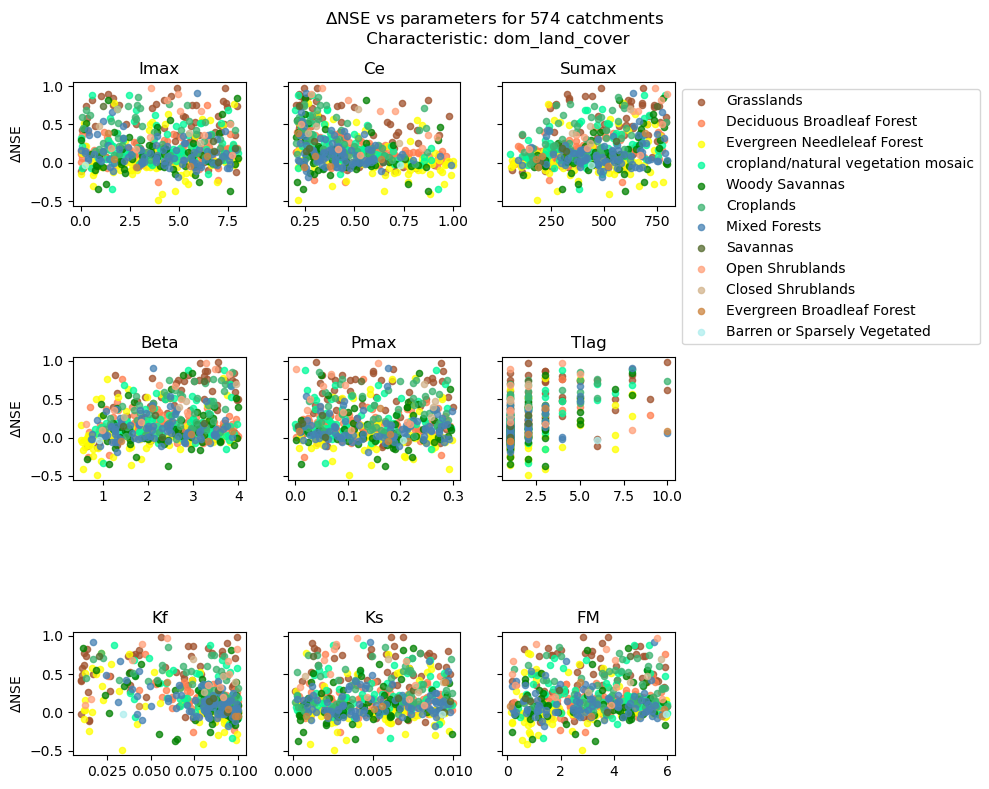

In [69]:
custom_color_list = ["sienna","coral","yellow","mediumspringgreen","green",
                                                "mediumseagreen","steelblue","darkolivegreen","lightsalmon","tan",
                                                "peru","paleturquoise"]
fig, axs = plot_yvar_text('NSE_delta_best', 'dom_land_cover', lst_results_char[dict_names_list['vege']], custom_color_list,show_cal=False, save=False)
# plt.colorbar(ax)
fig.tight_layout()

## All 

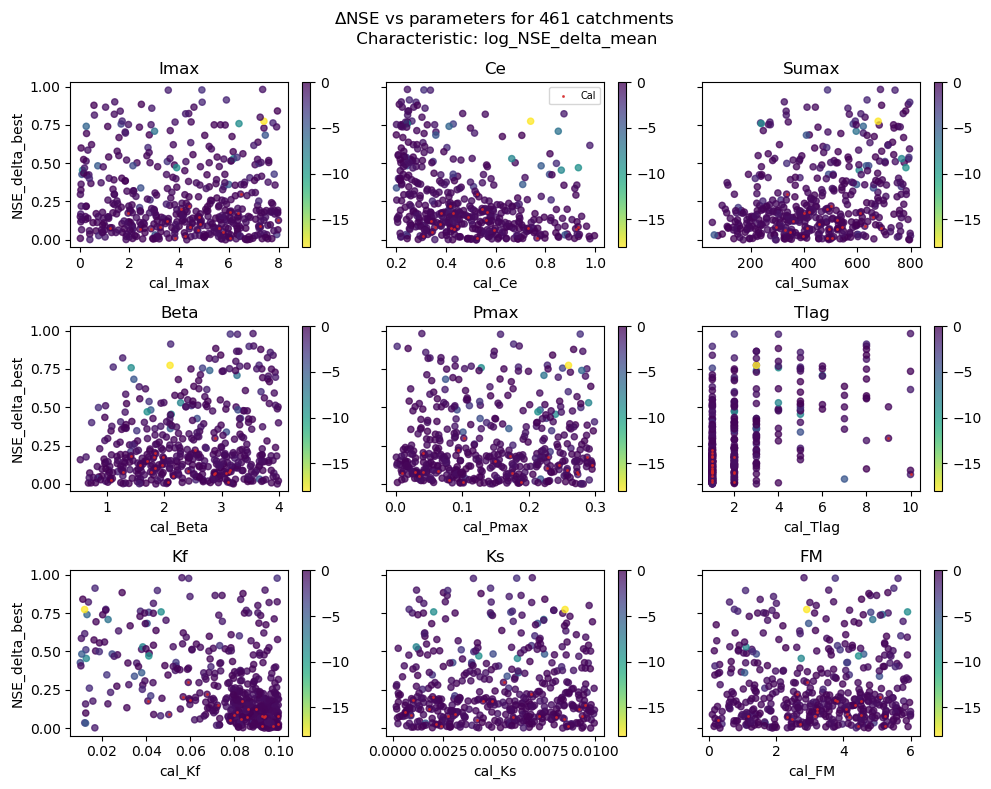

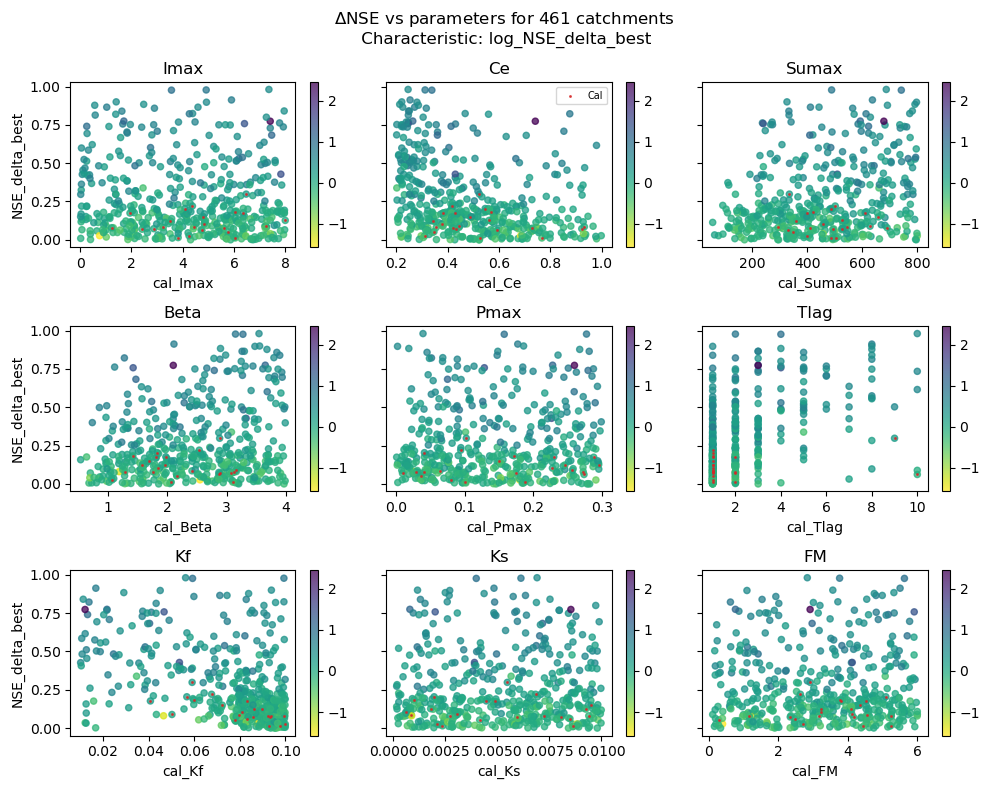

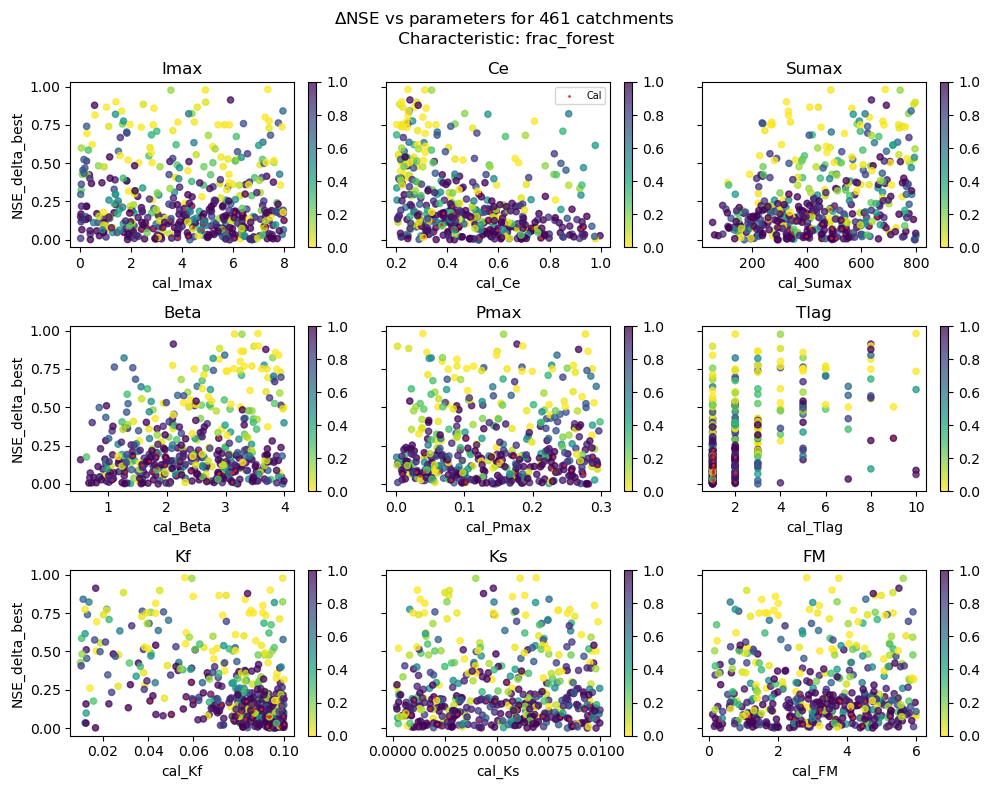

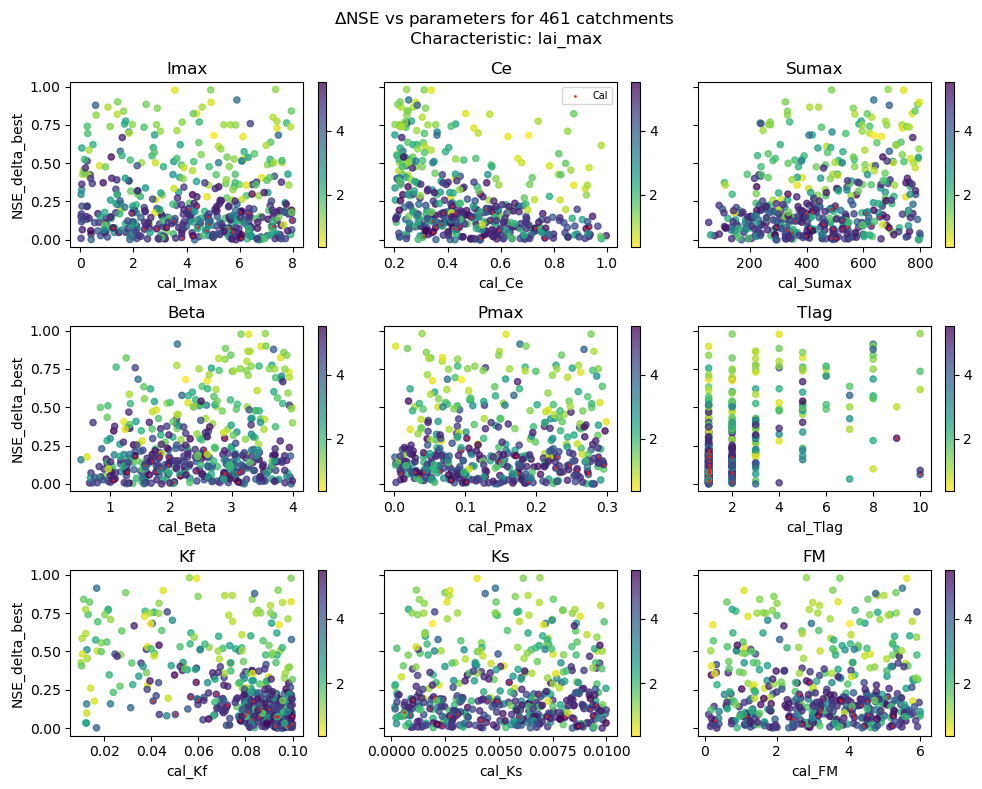

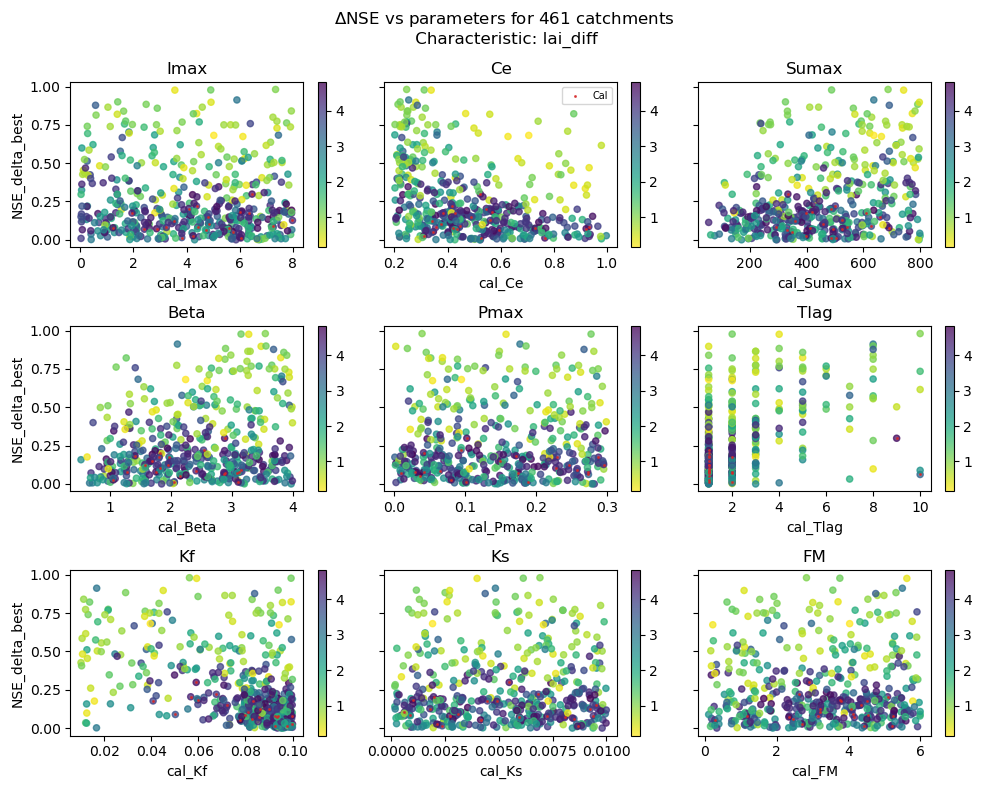

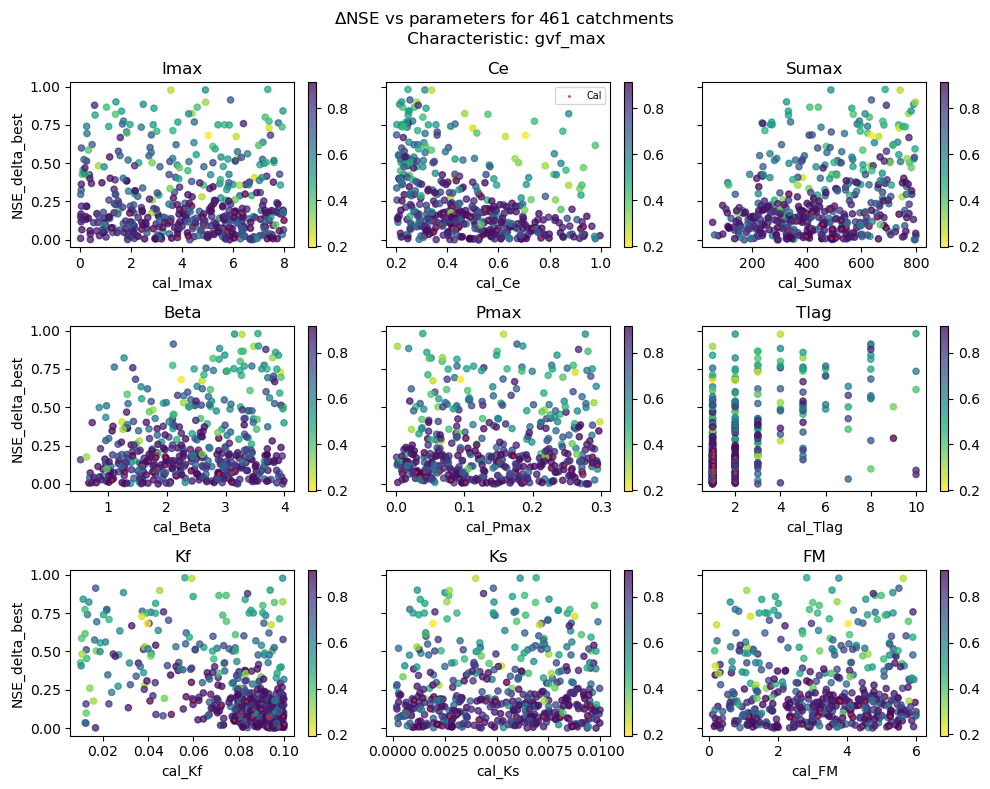

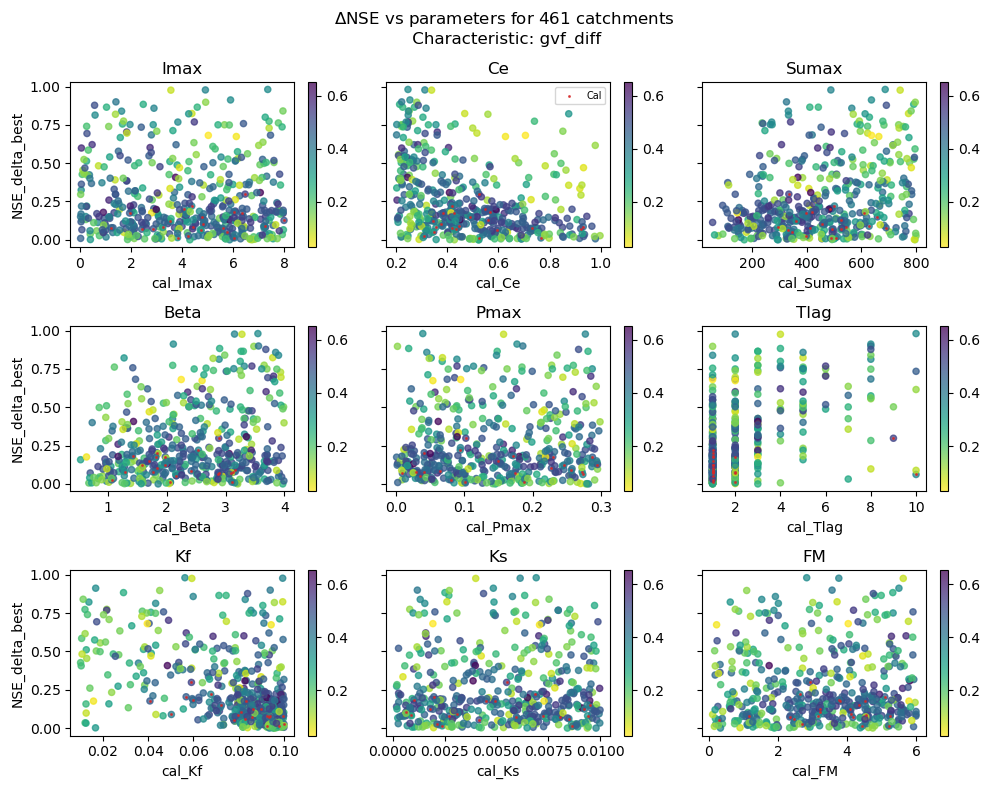

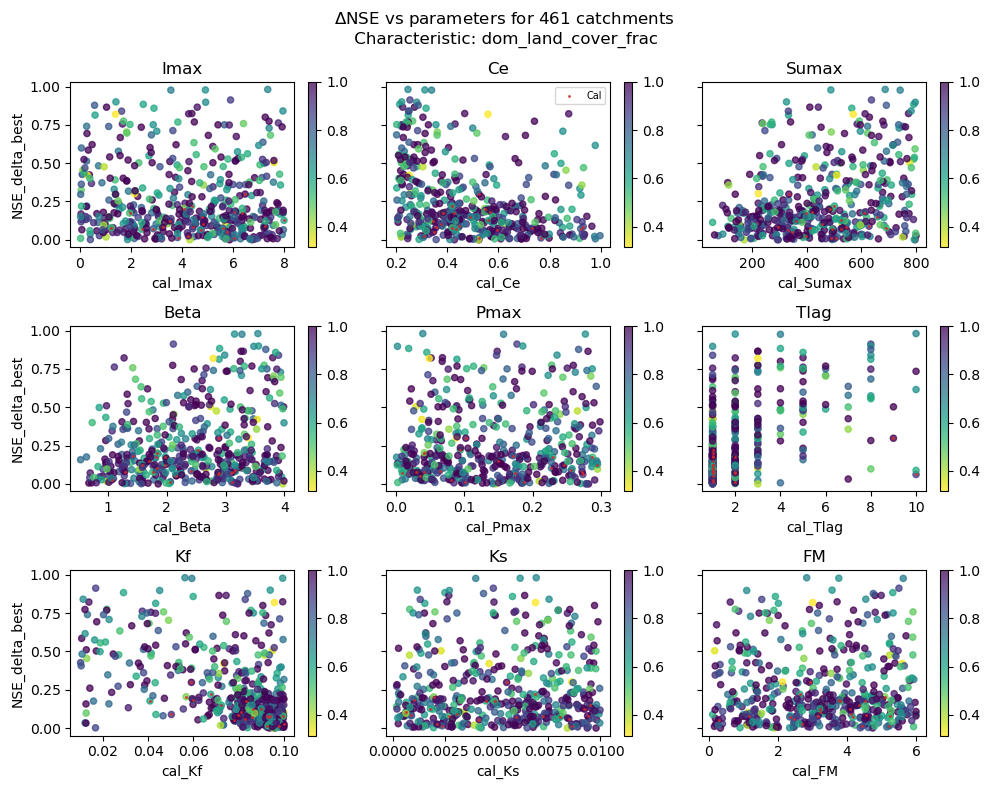

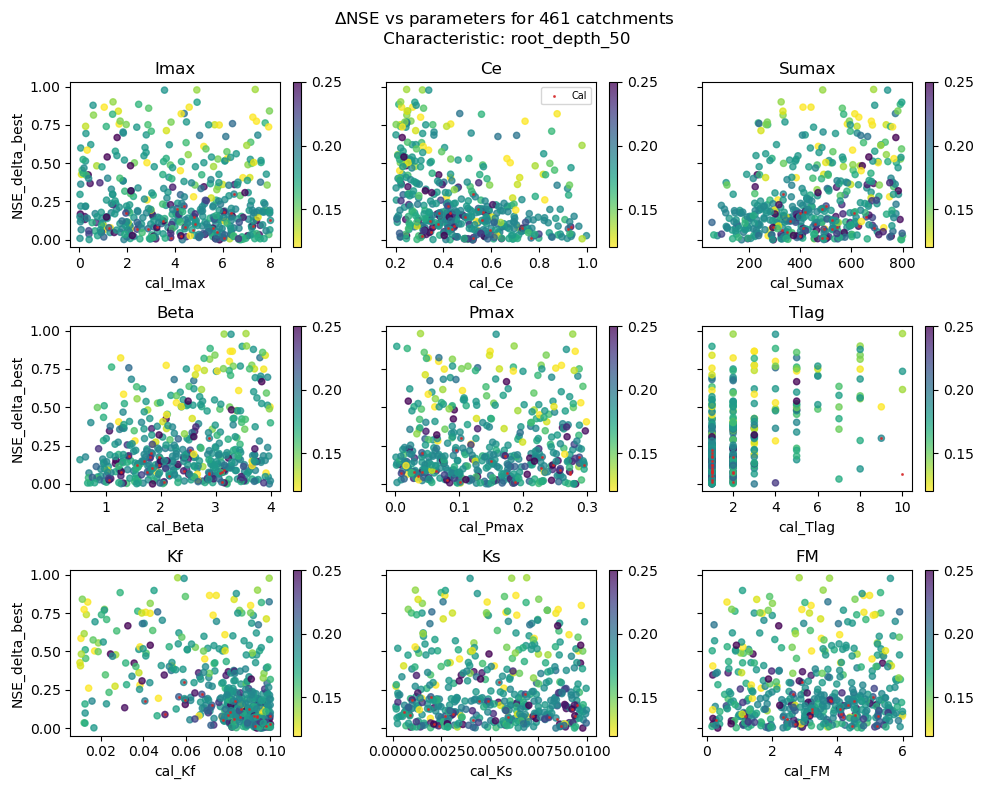

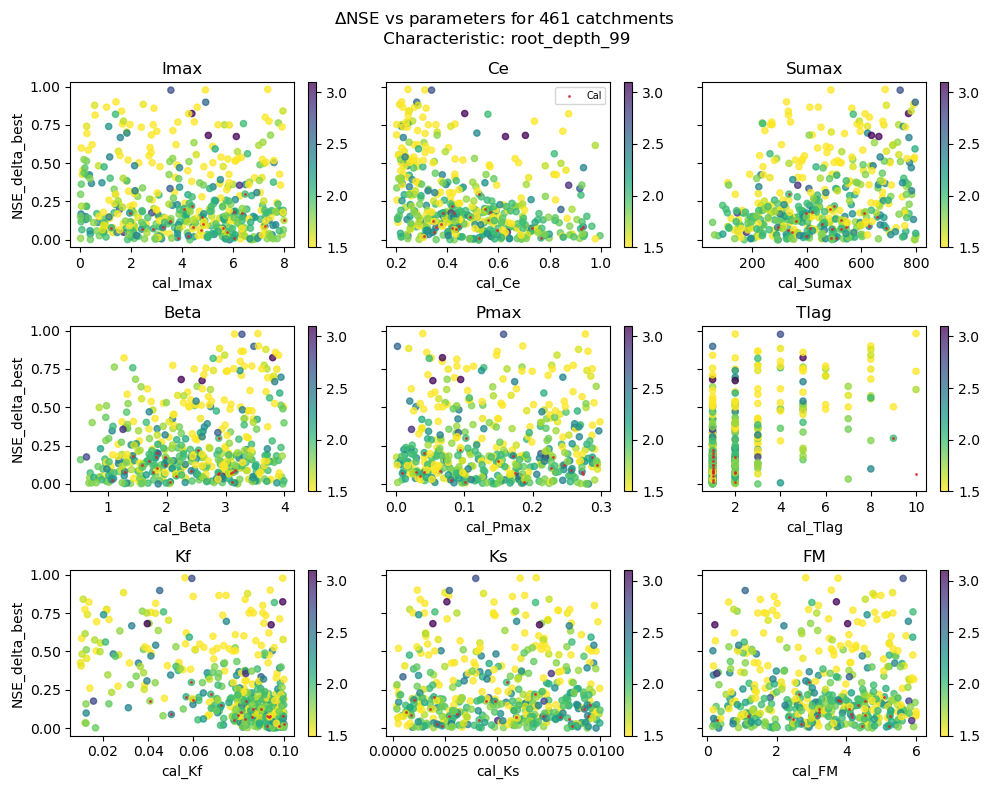

In [72]:
plot_all('vege', 'NSE_delta_best', lst_results_char, dict_names_list, show_cal=True, save=False)

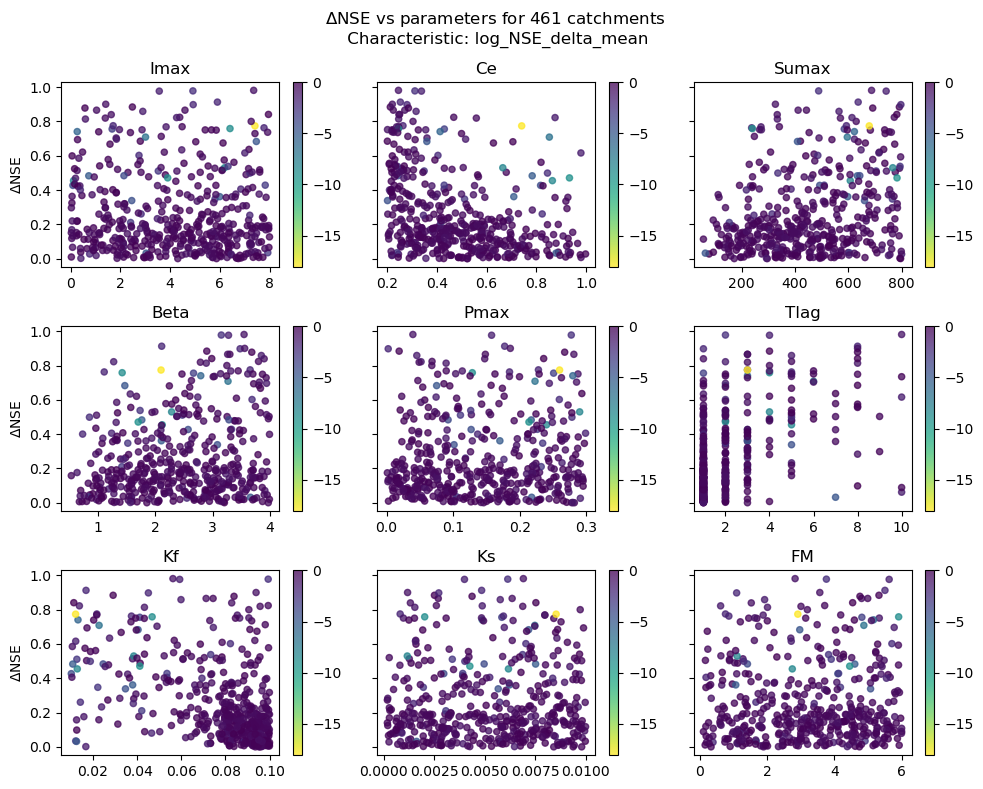

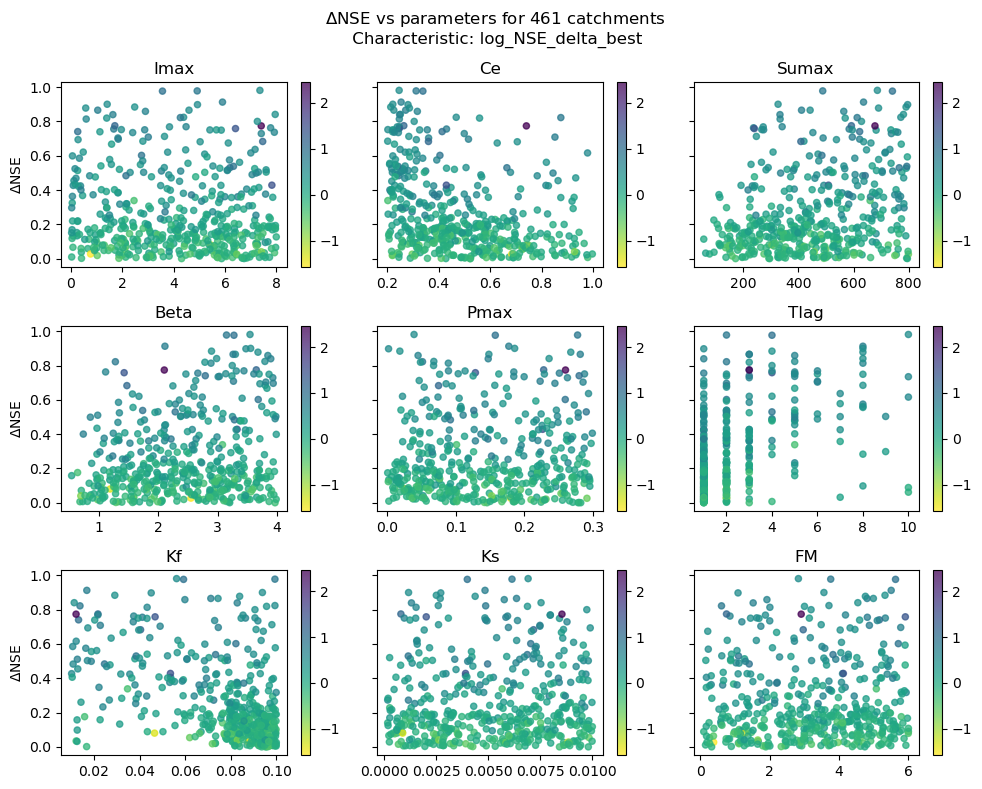

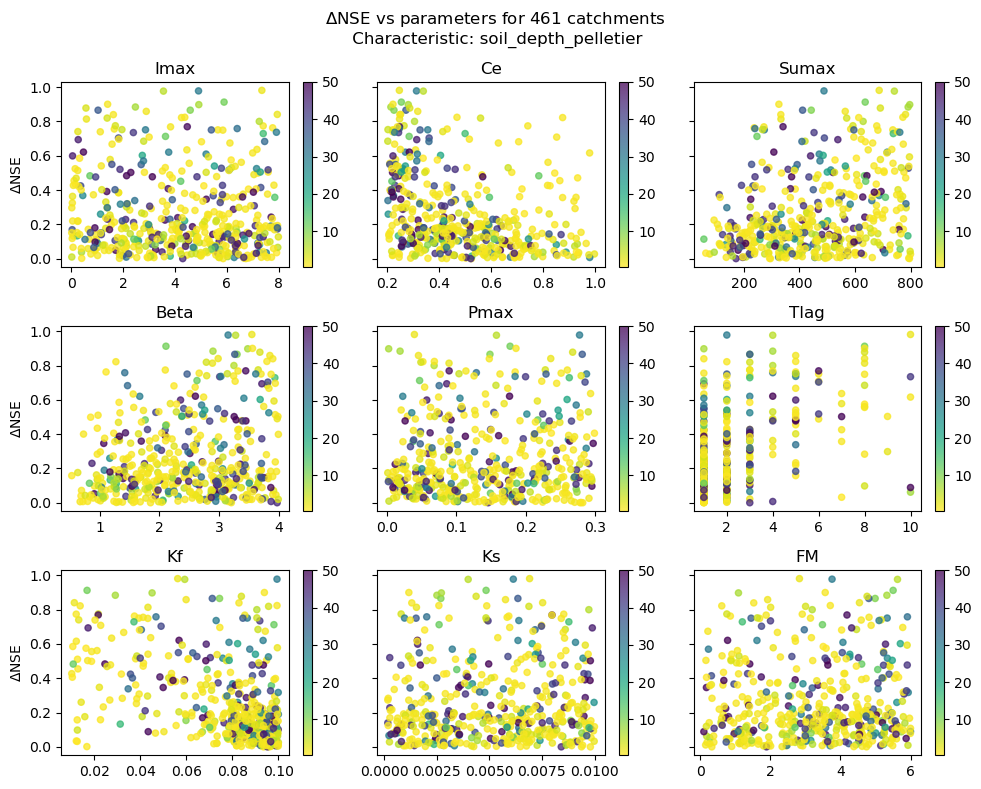

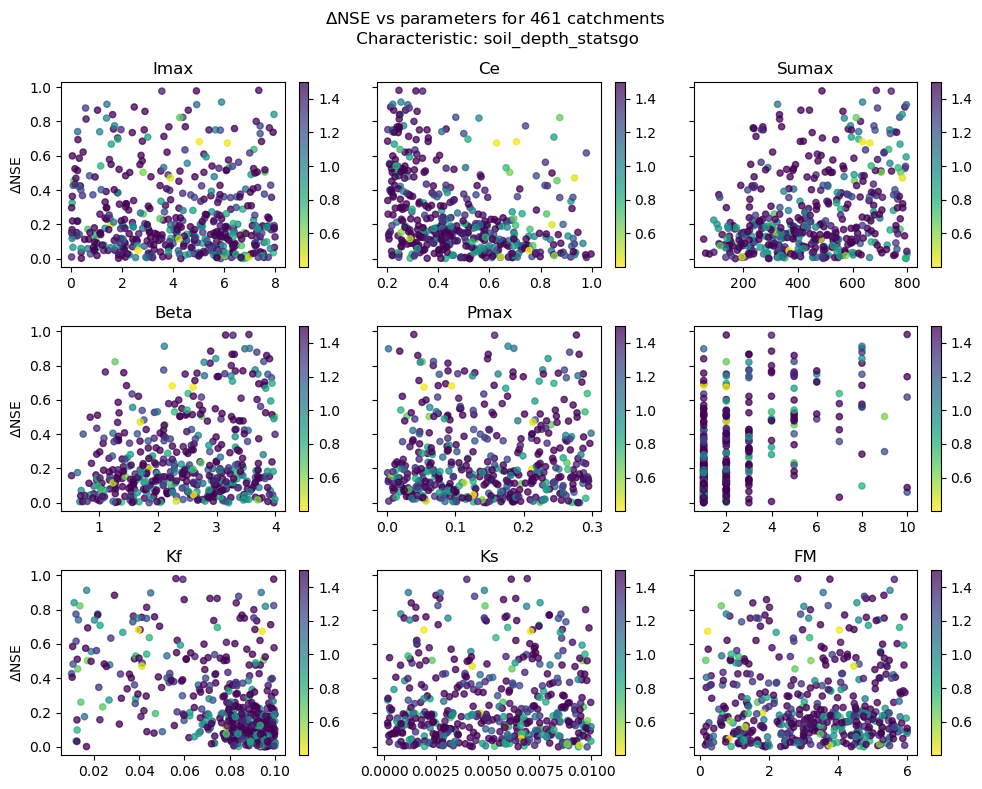

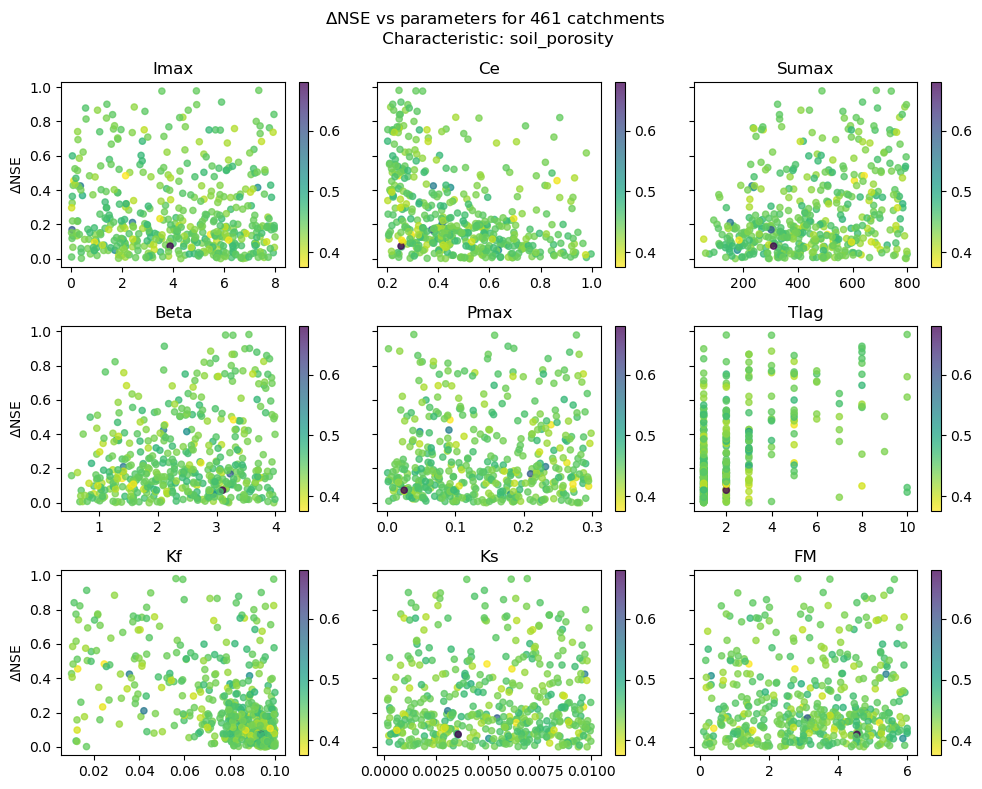

...

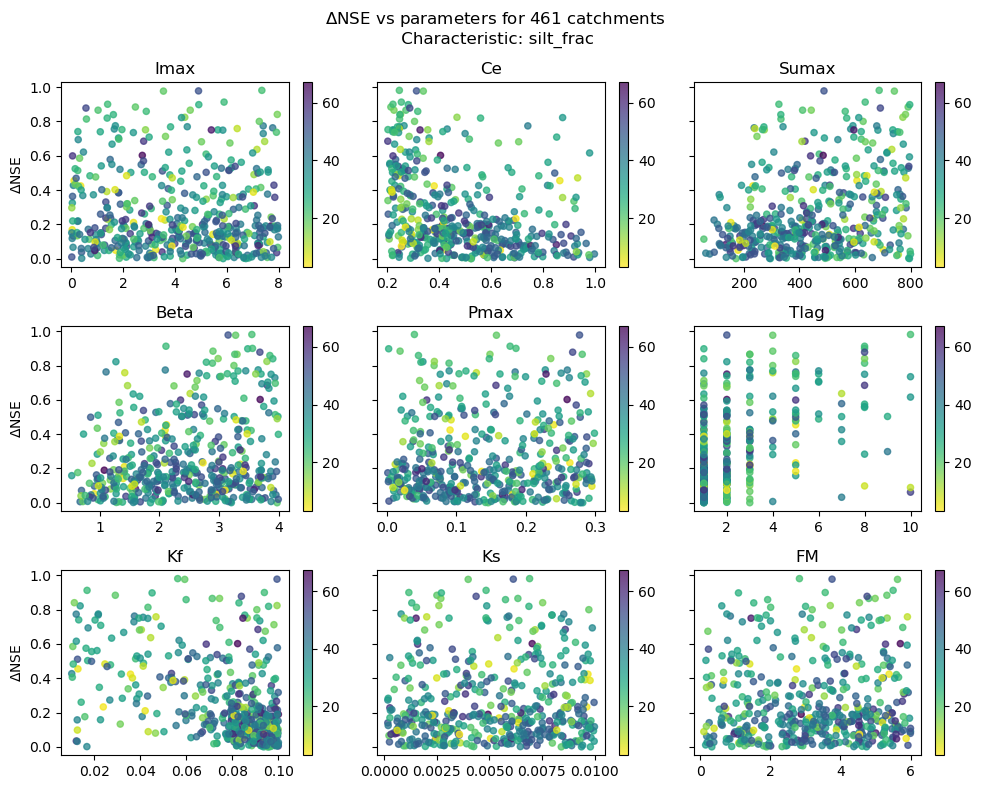

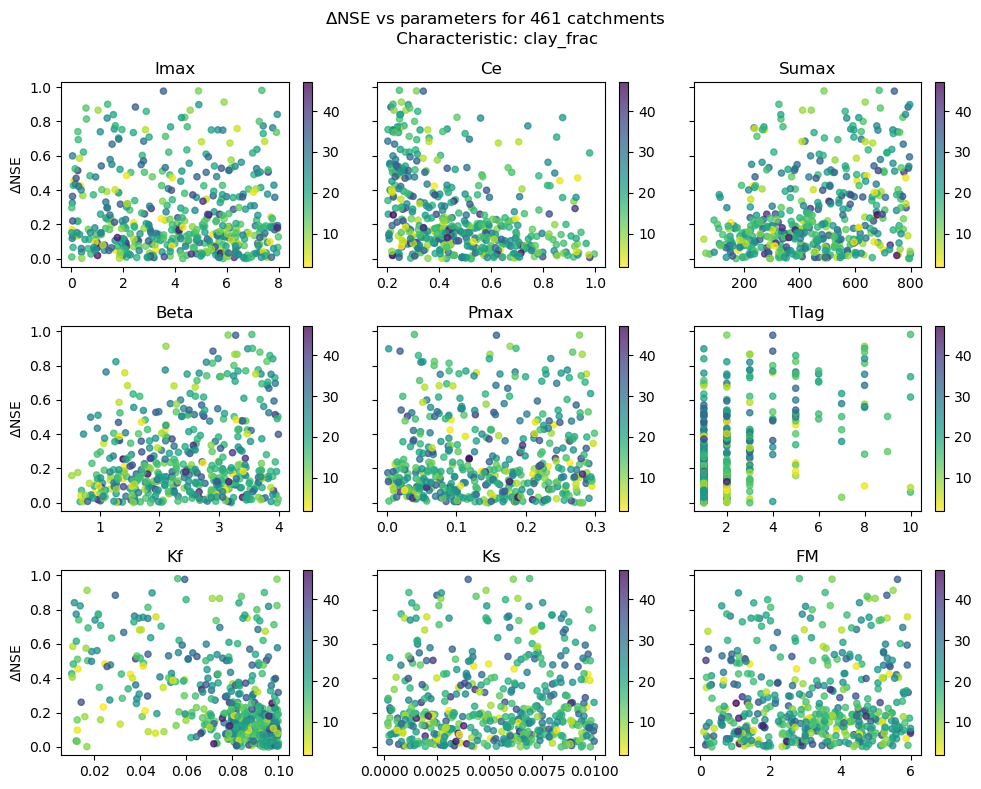

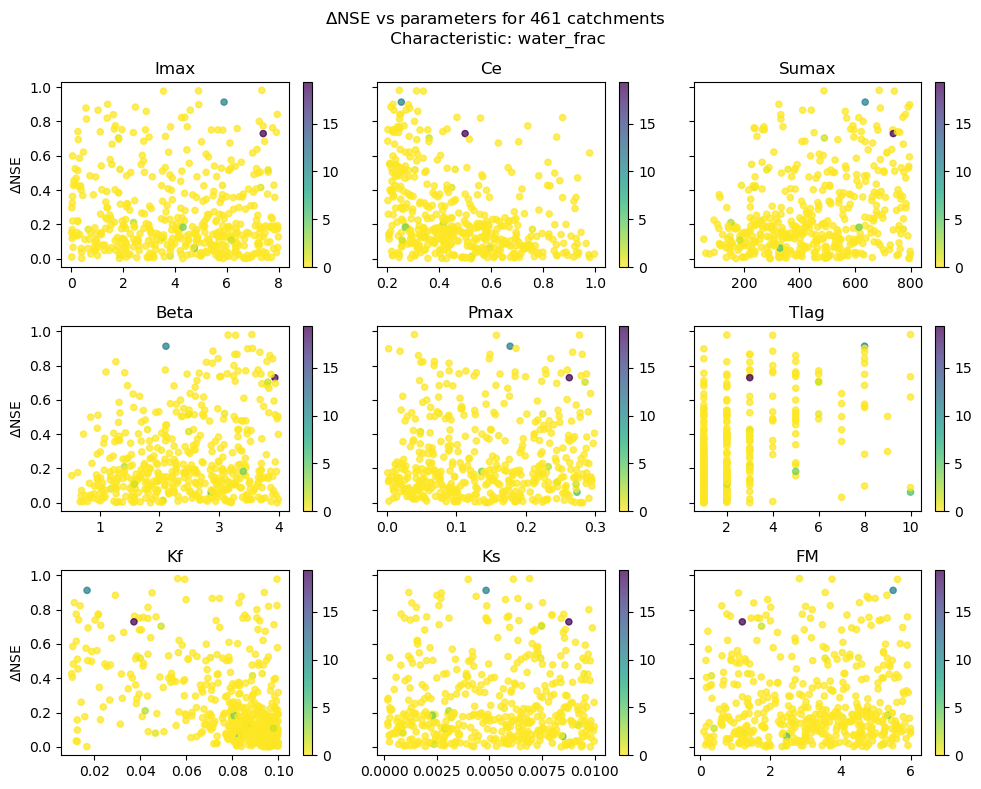

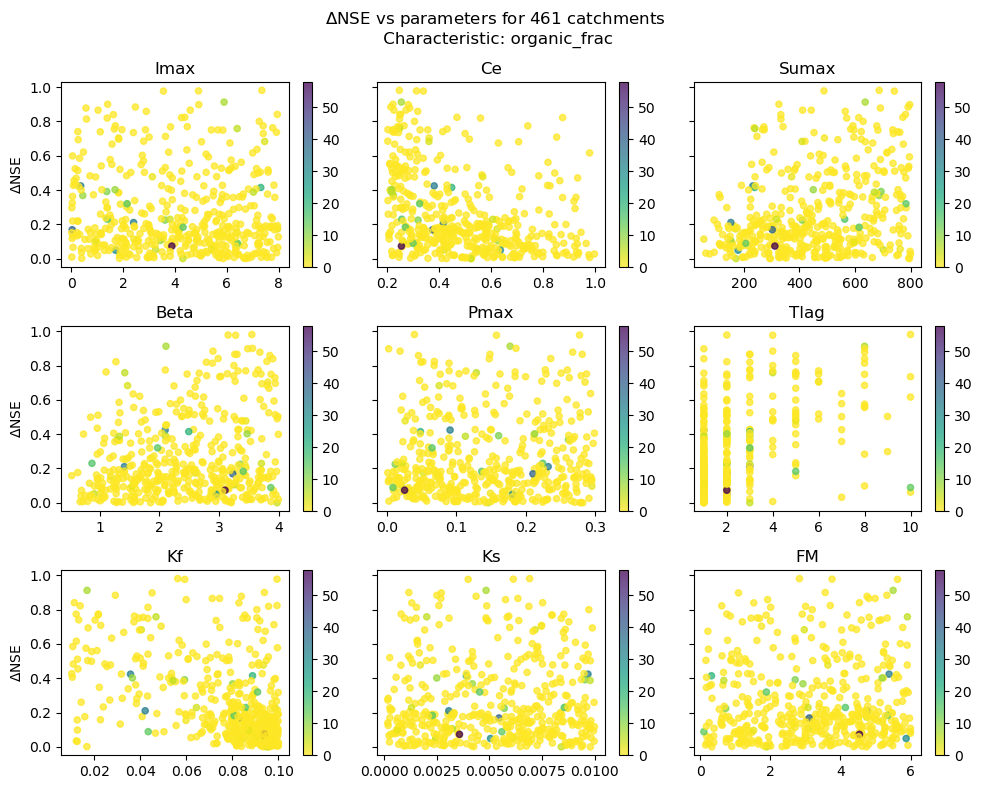

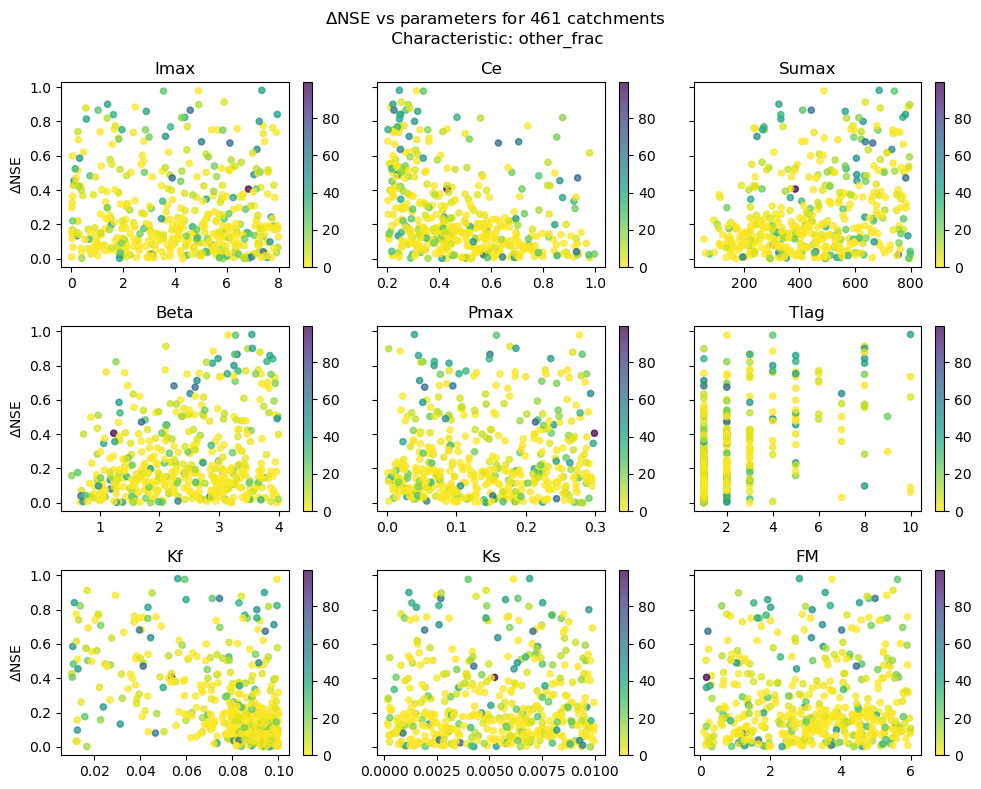

In [73]:
plot_all('soil', 'NSE_delta_best', lst_results_char, dict_names_list)

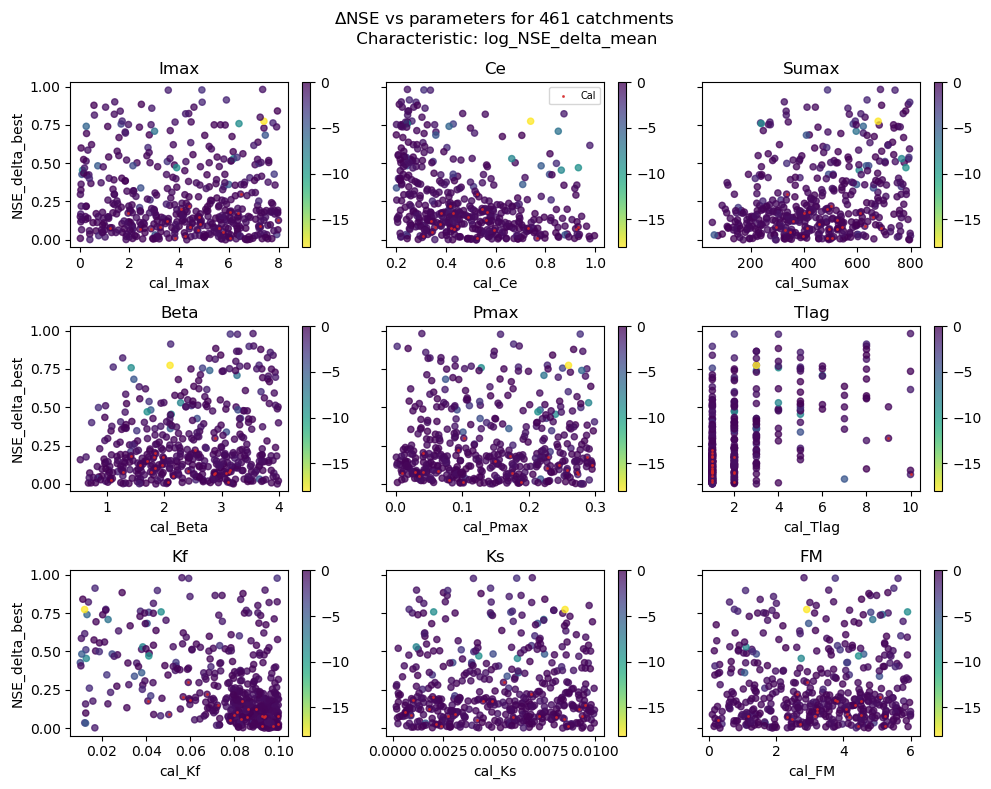

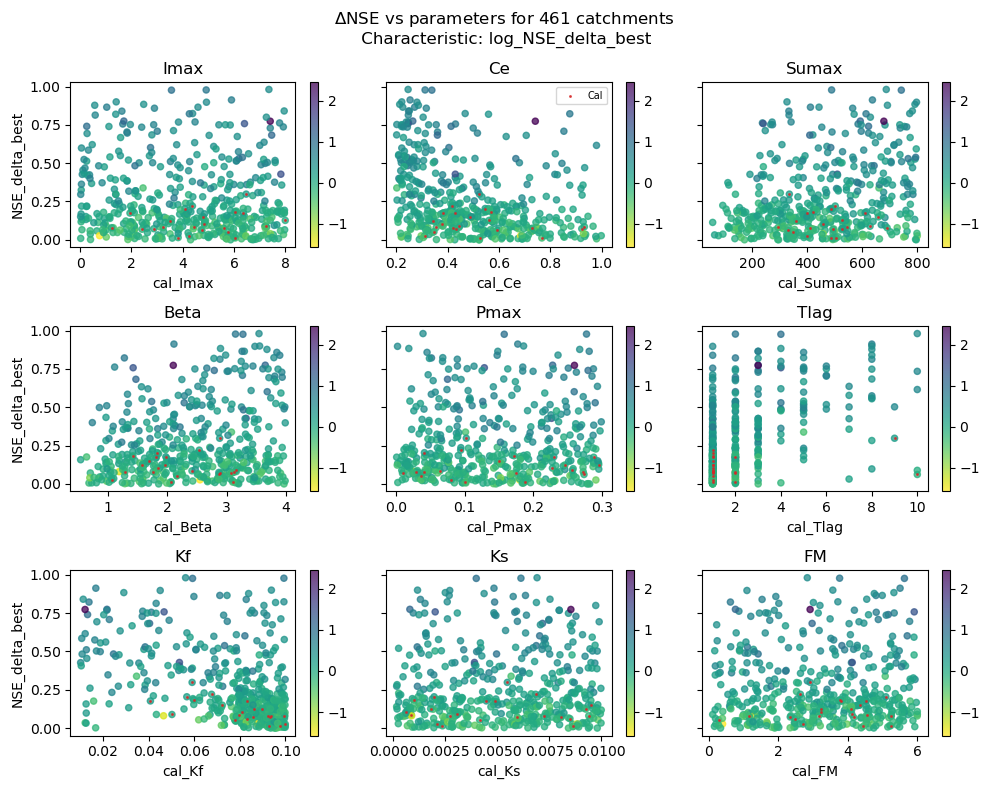

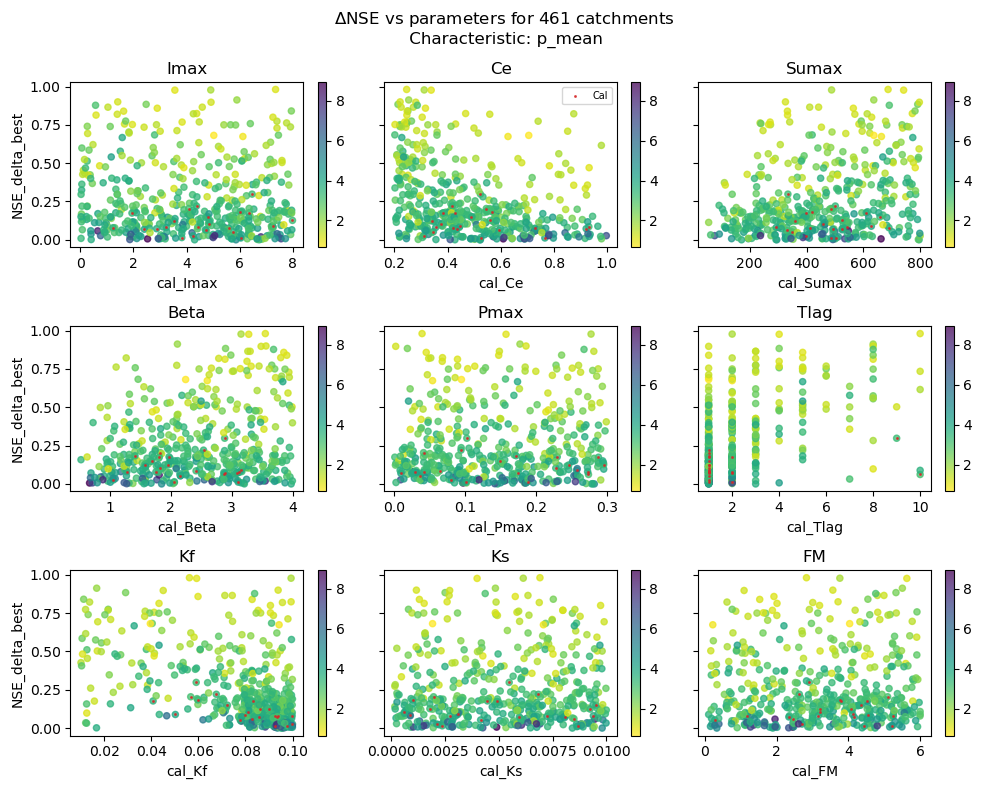

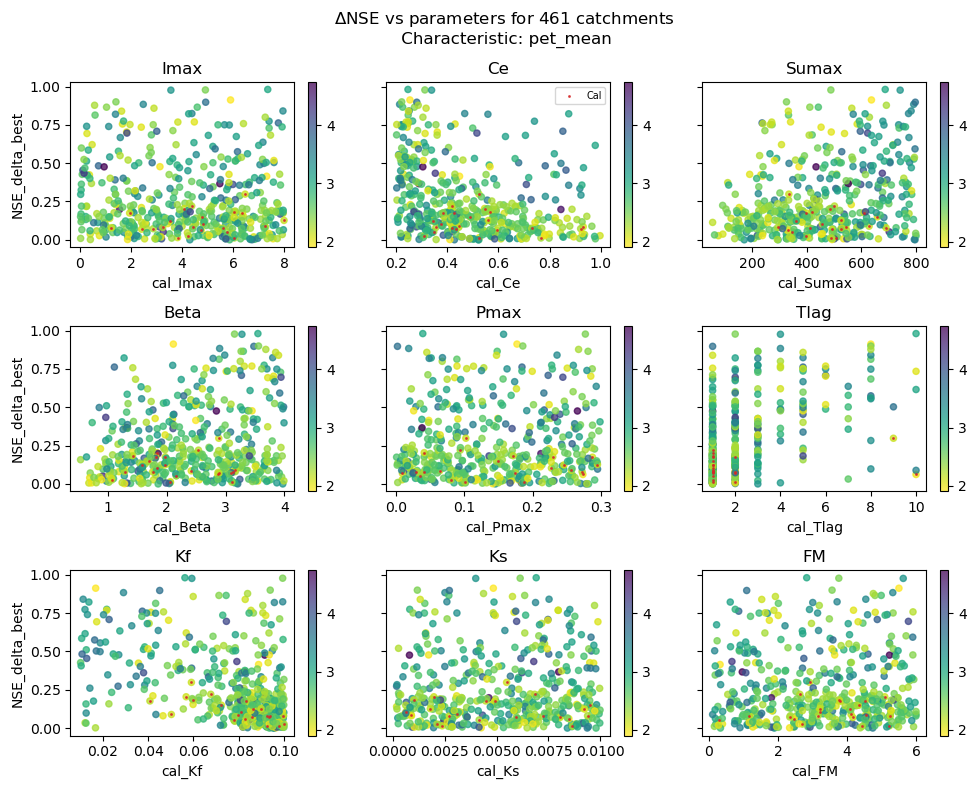

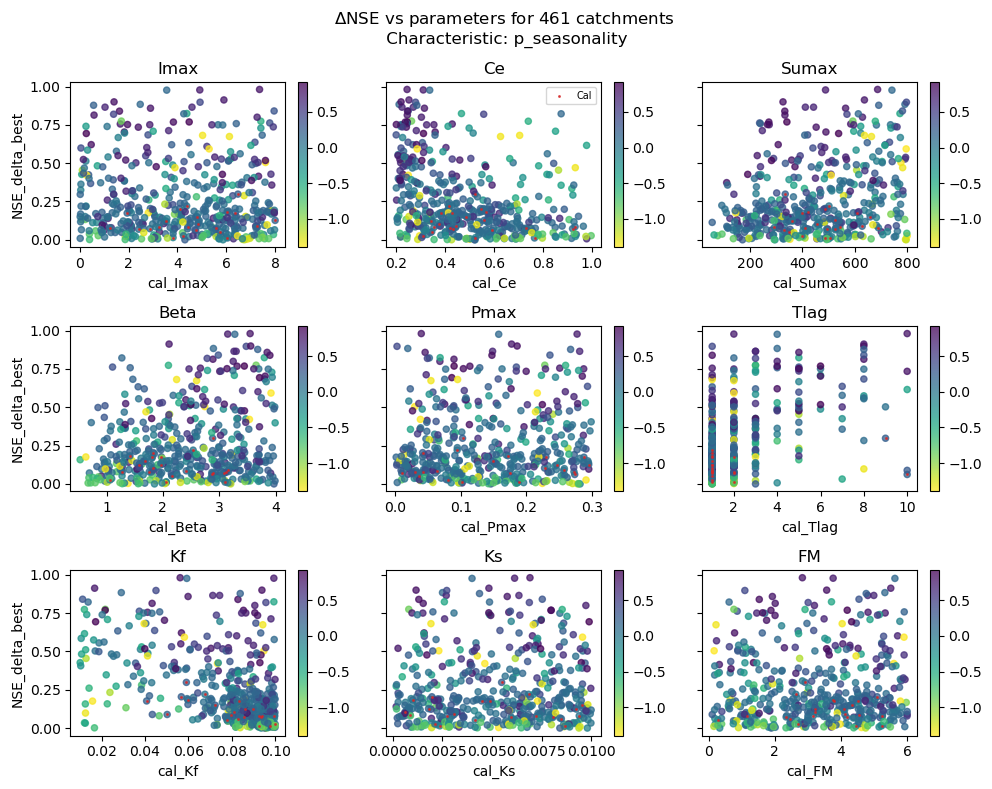

...

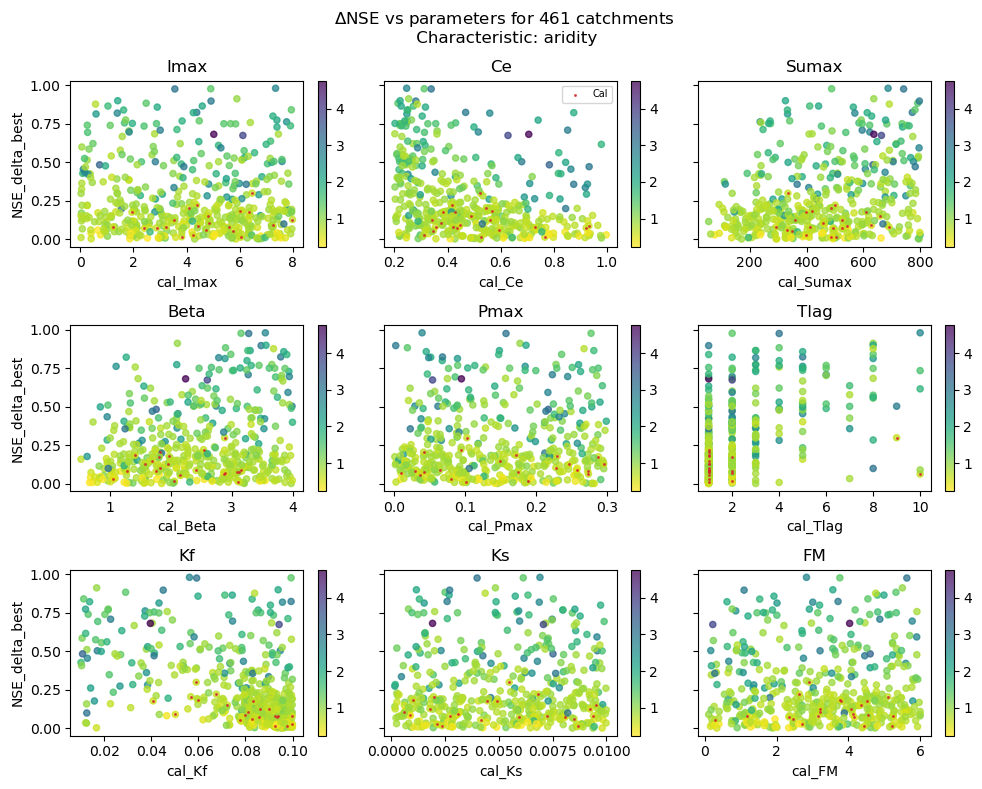

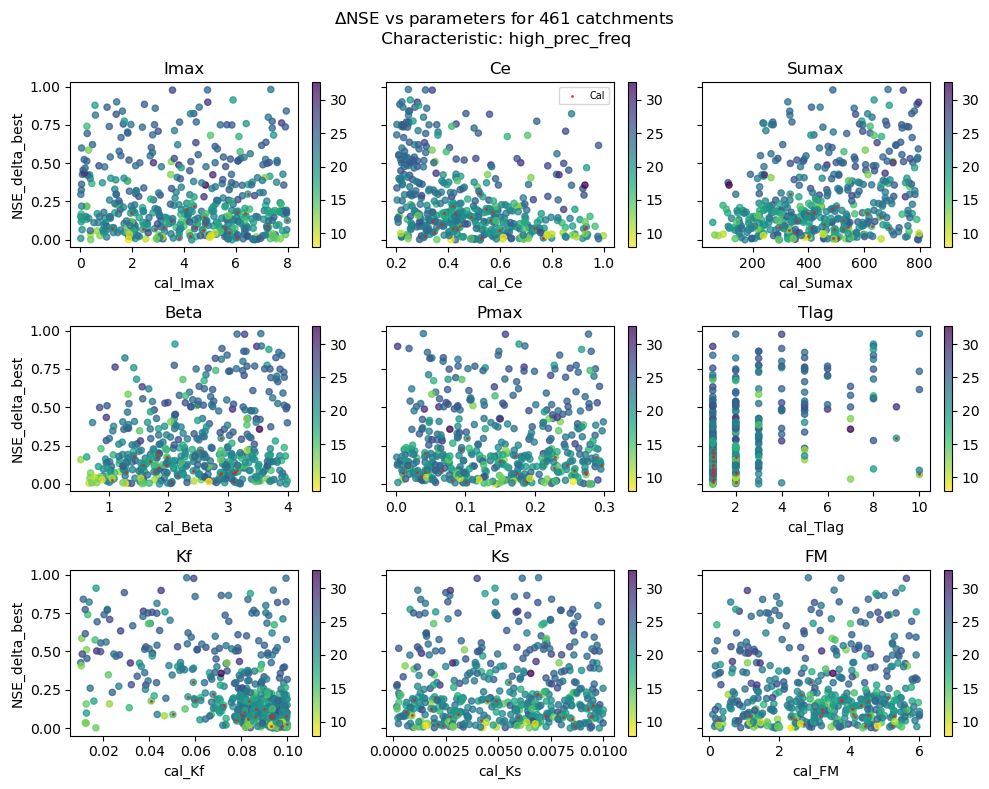

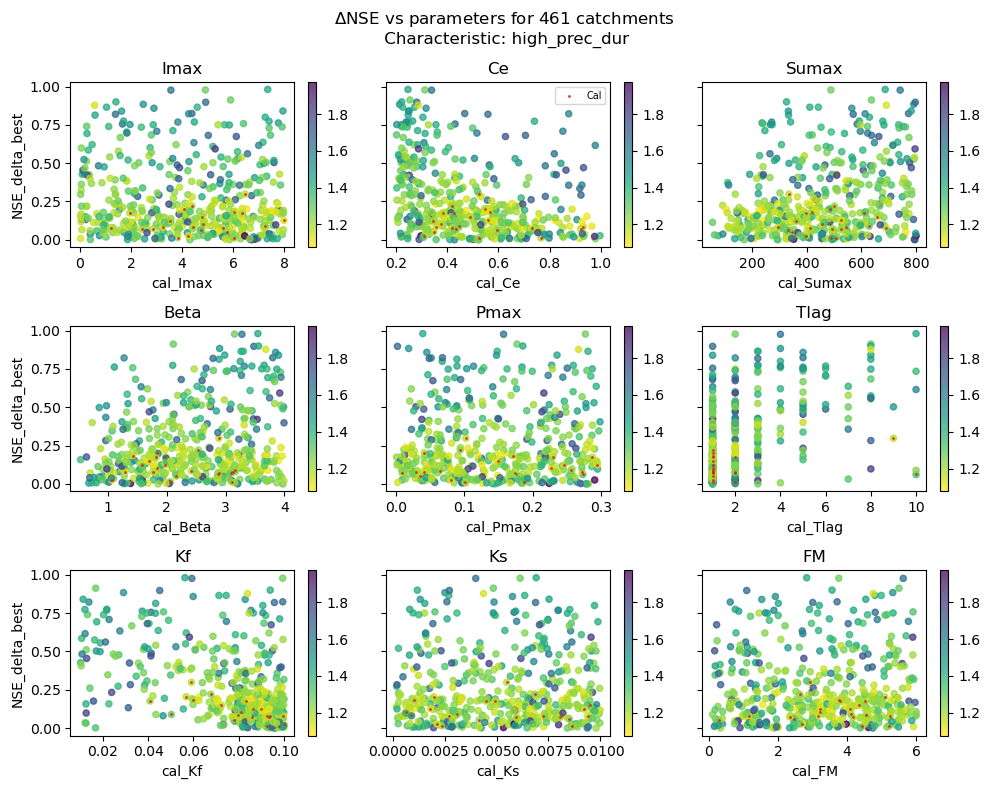

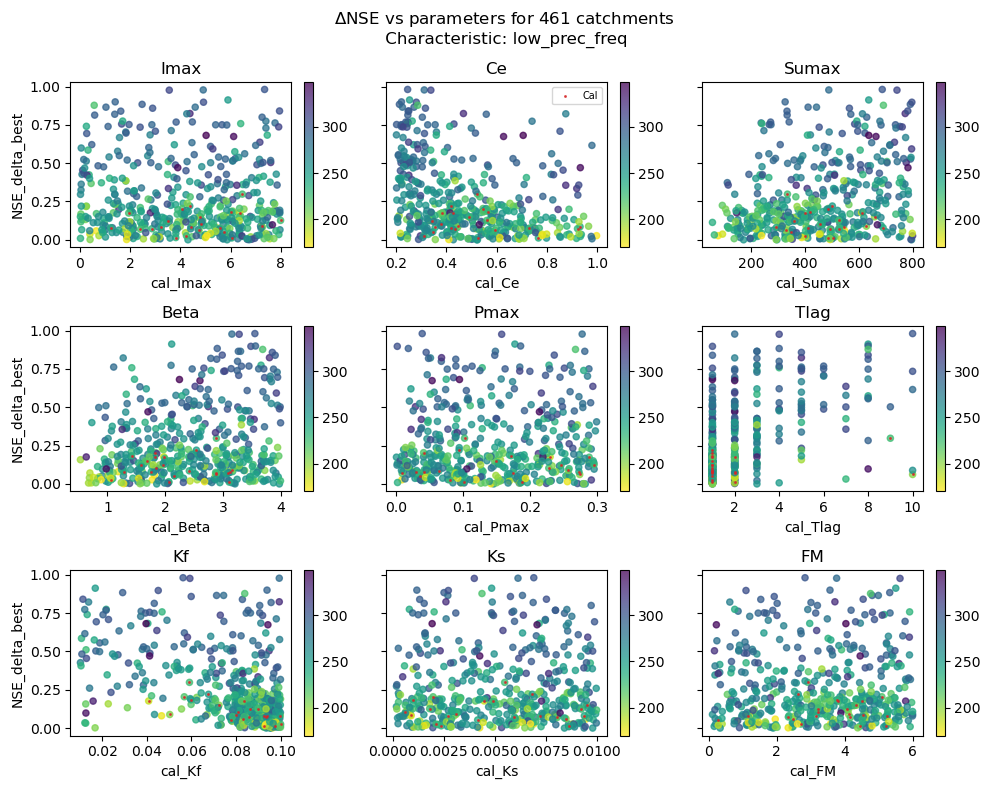

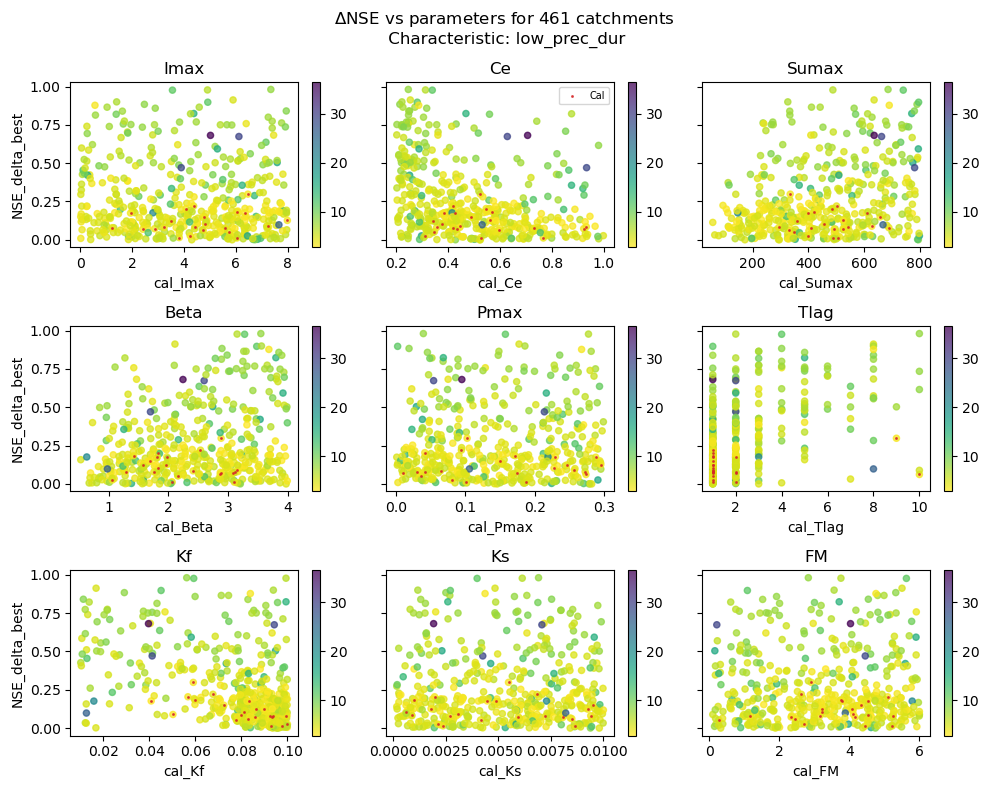

In [74]:
plot_all('clim', 'NSE_delta_best', lst_results_char, dict_names_list, True, save=False)

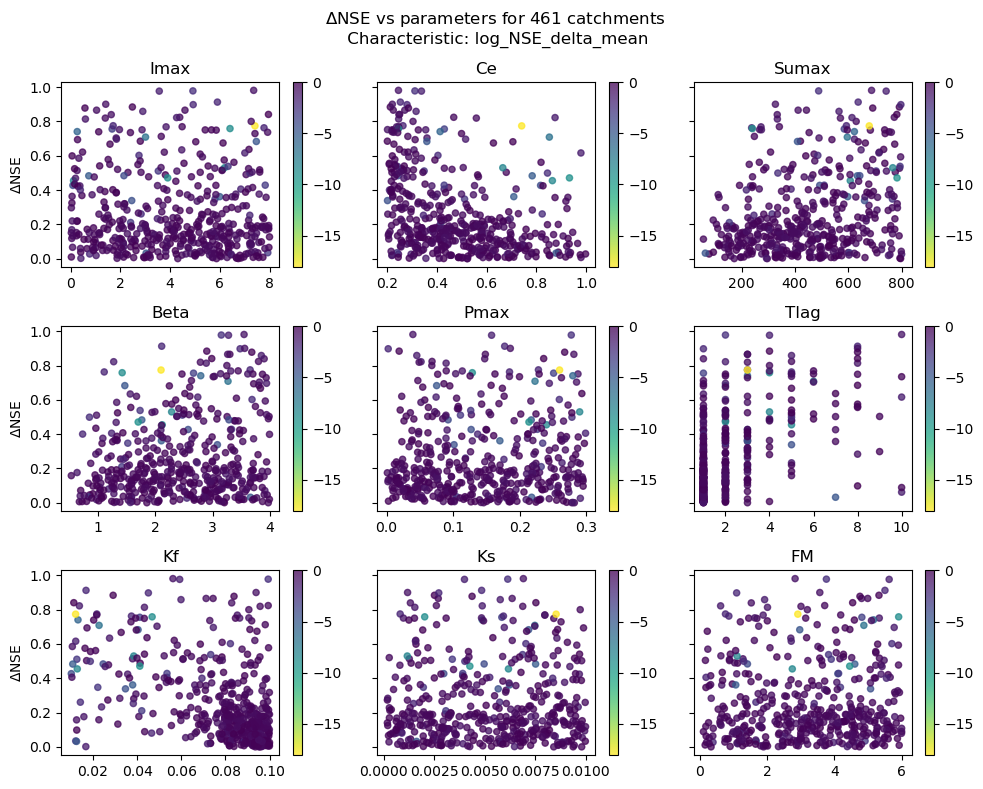

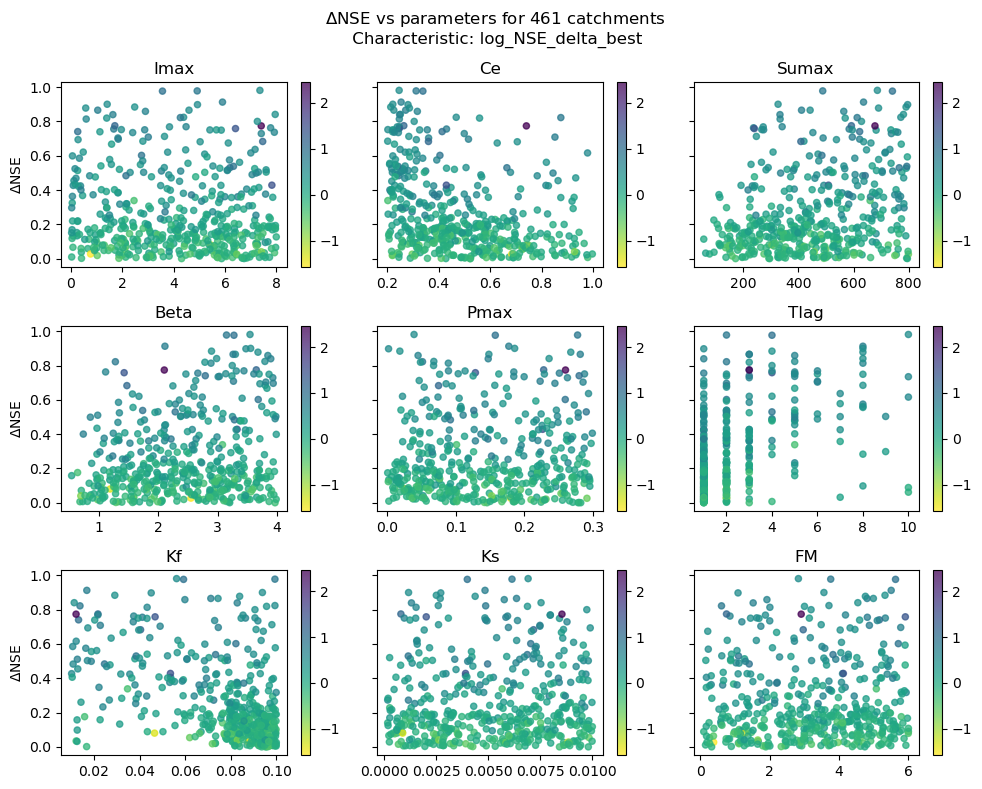

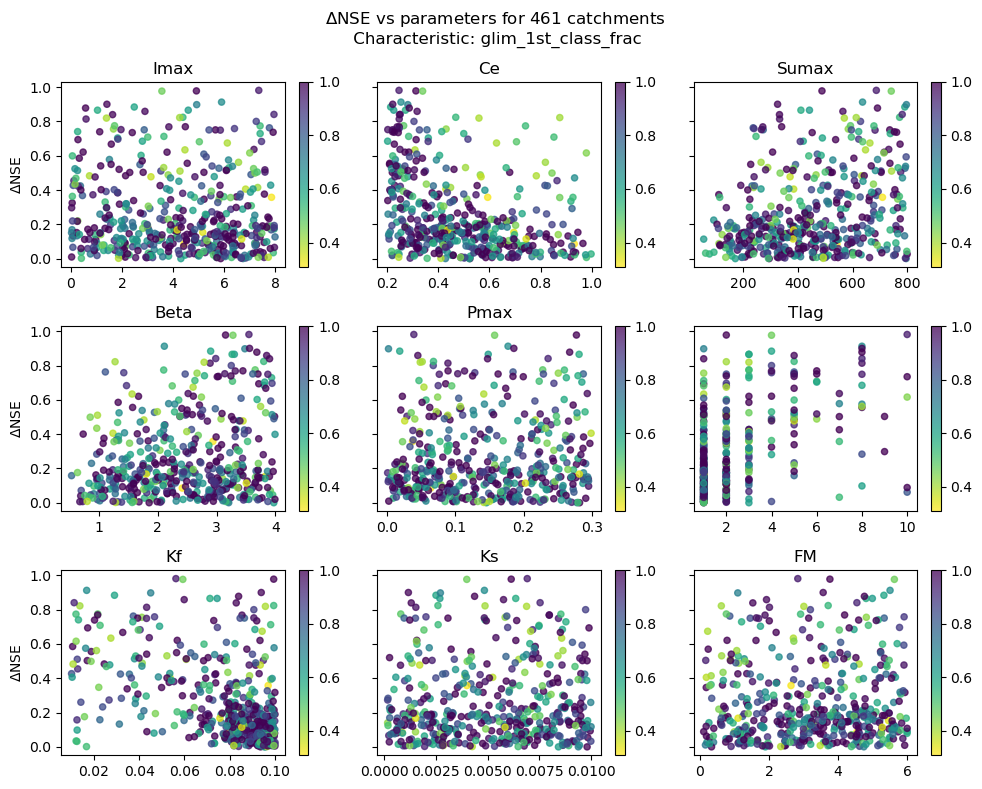

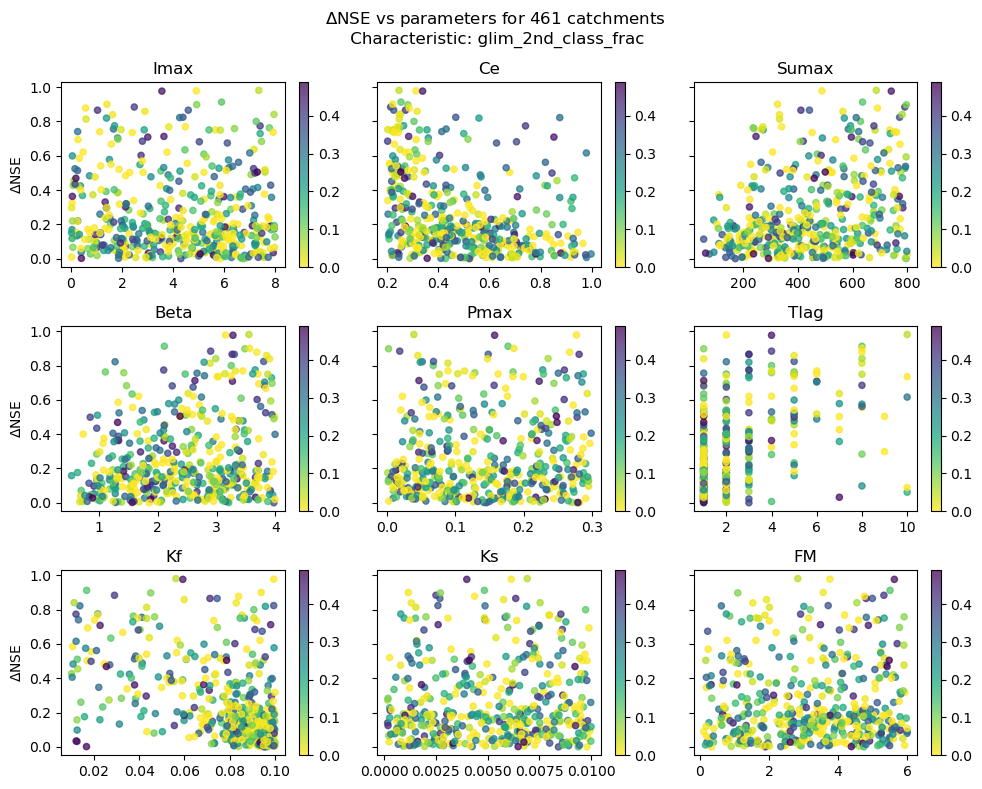

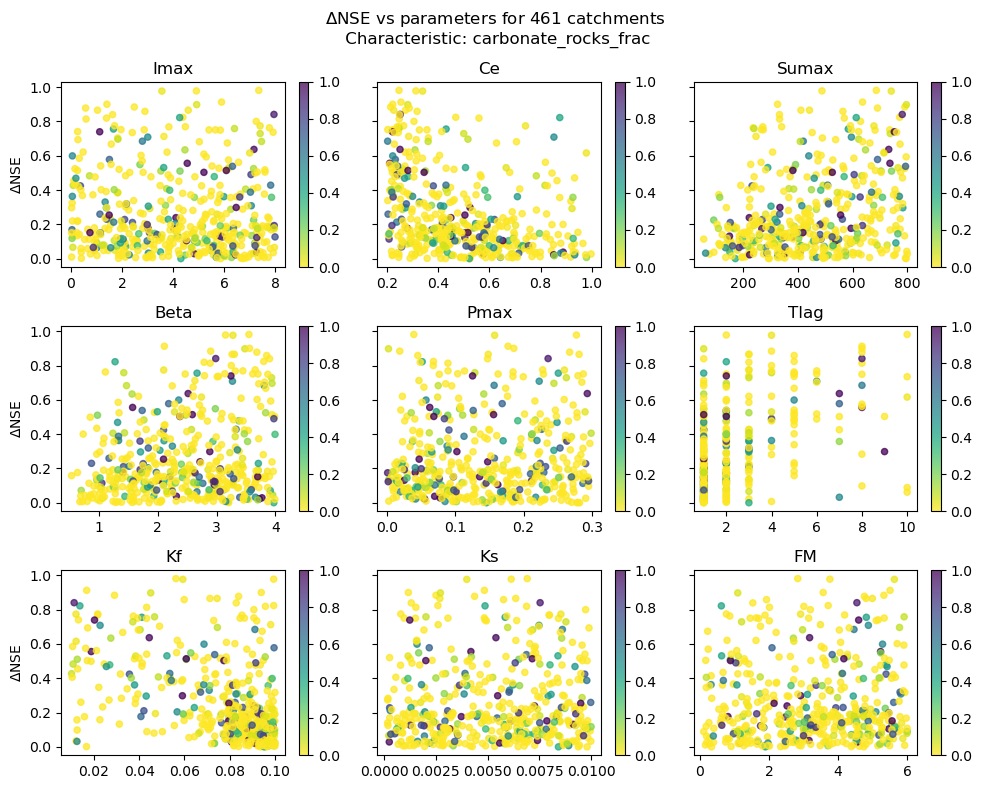

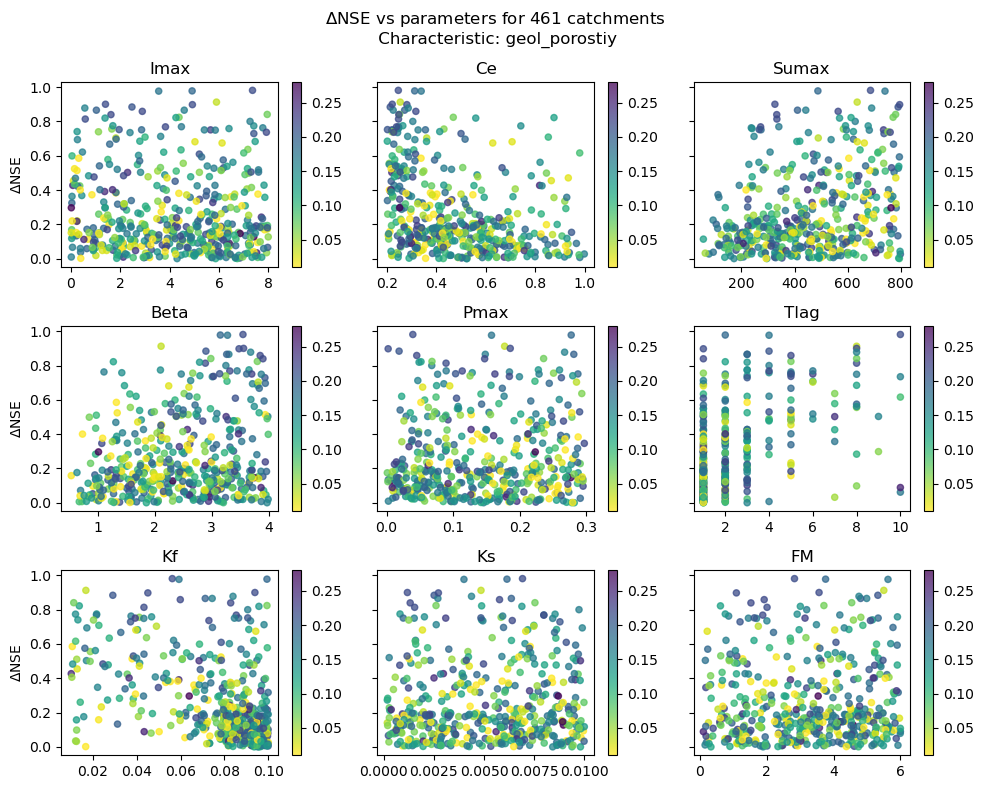

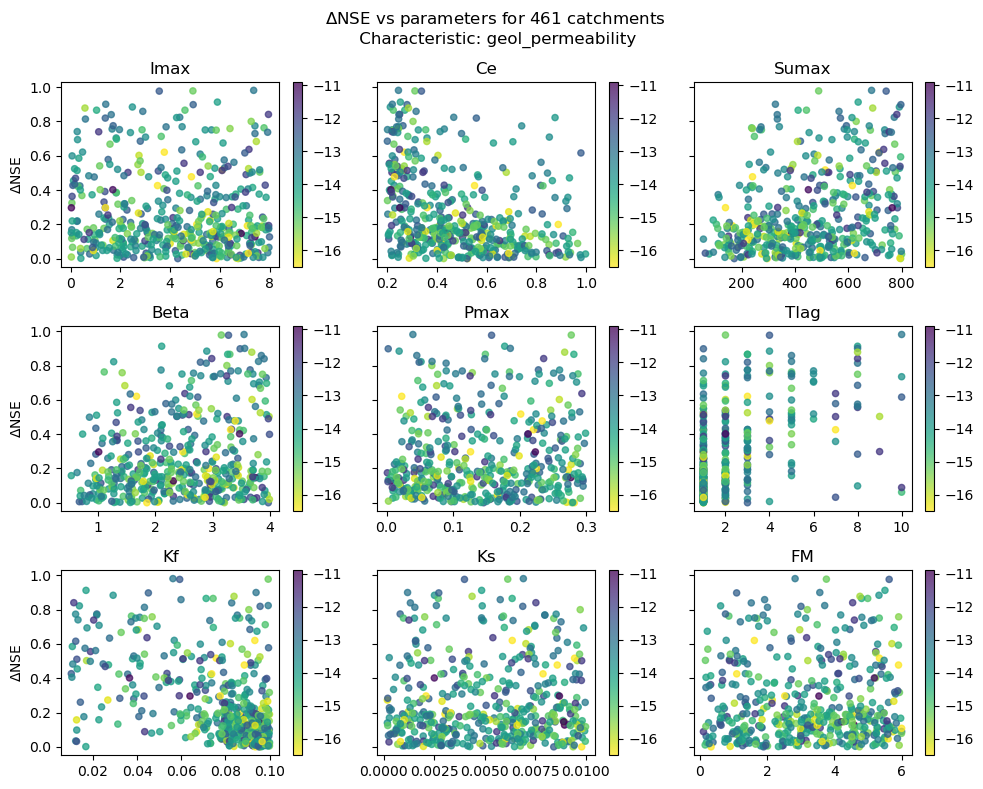

In [75]:
plot_all('geol', 'NSE_delta_best', lst_results_char, dict_names_list)

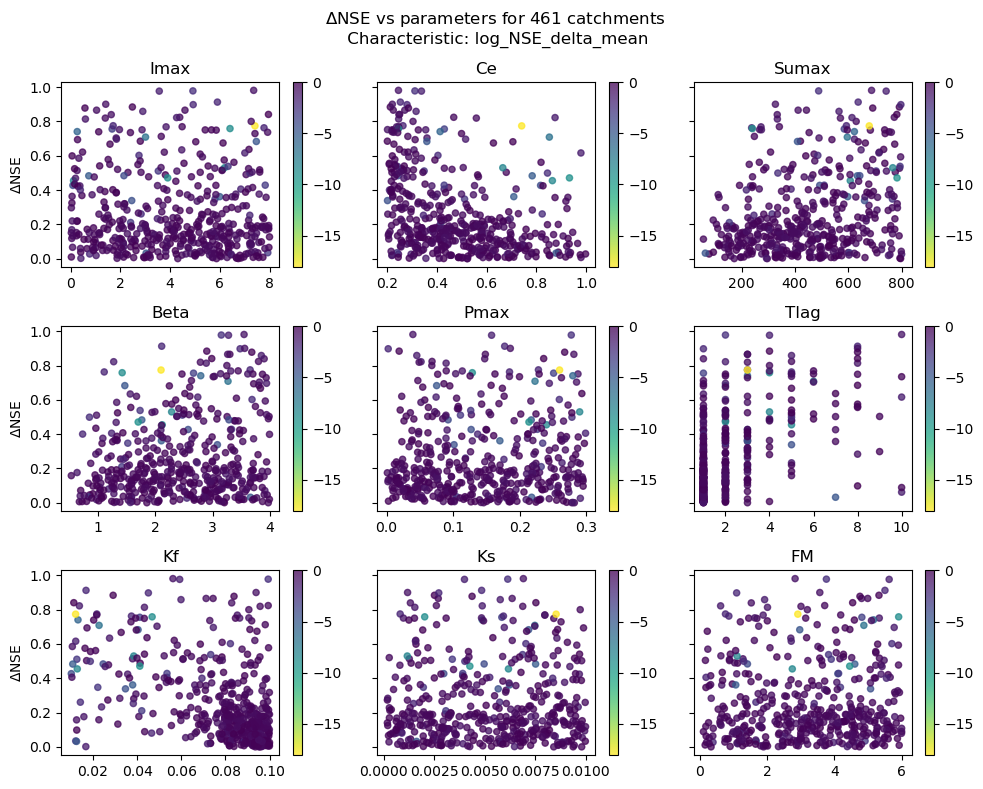

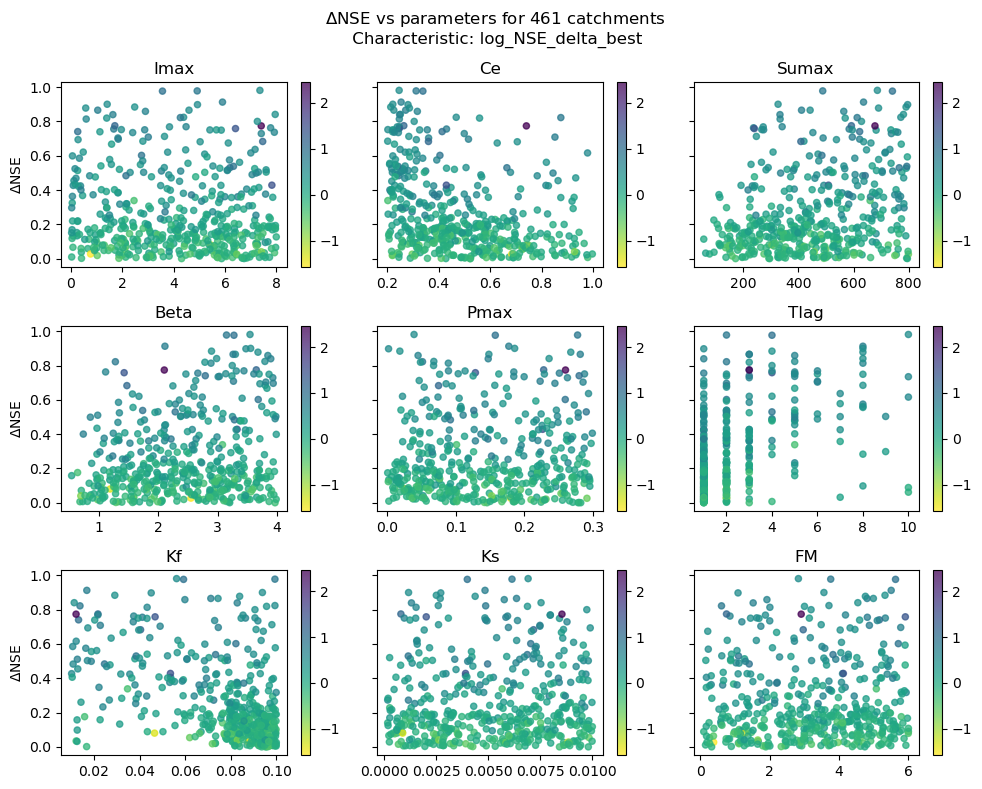

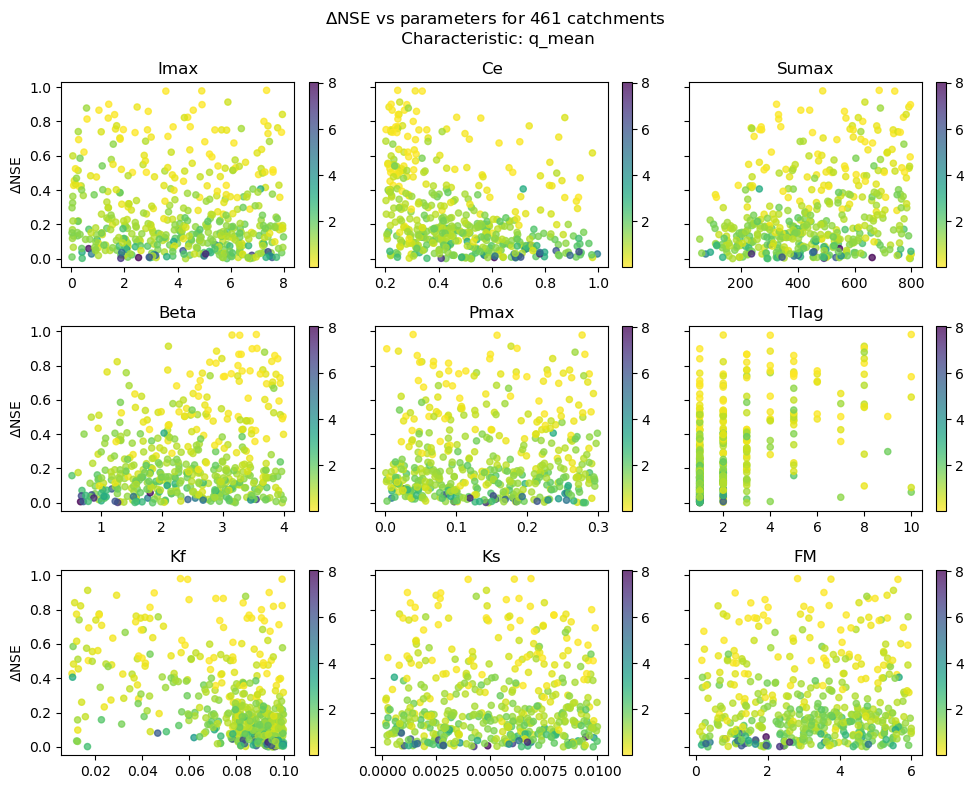

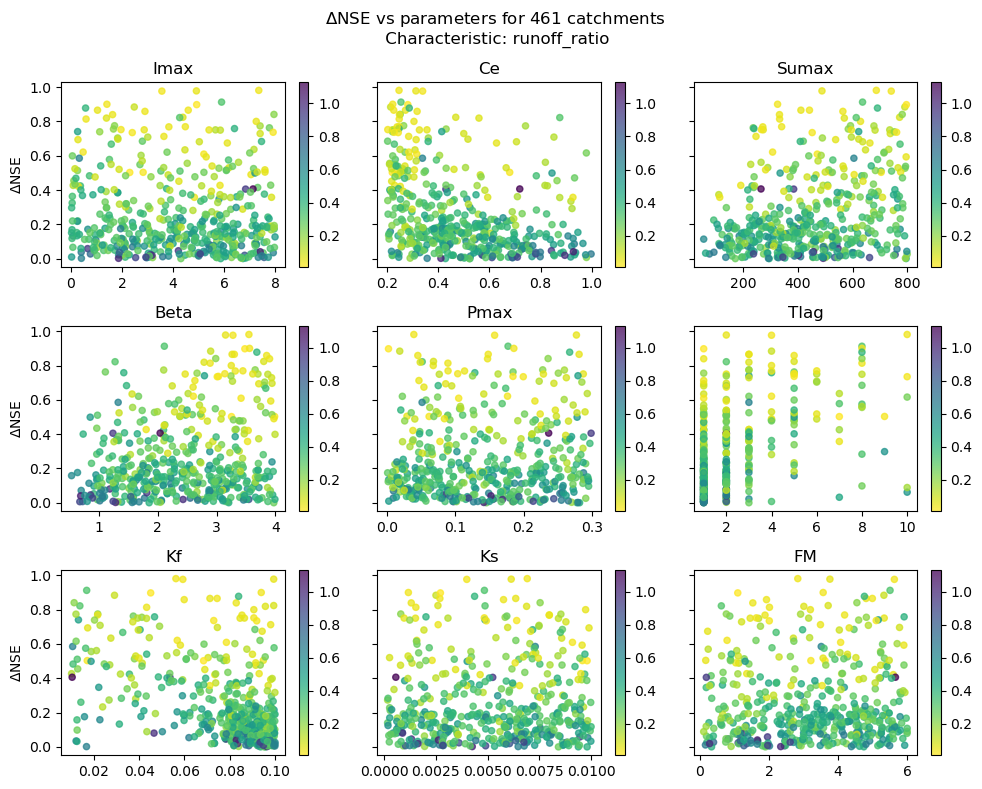

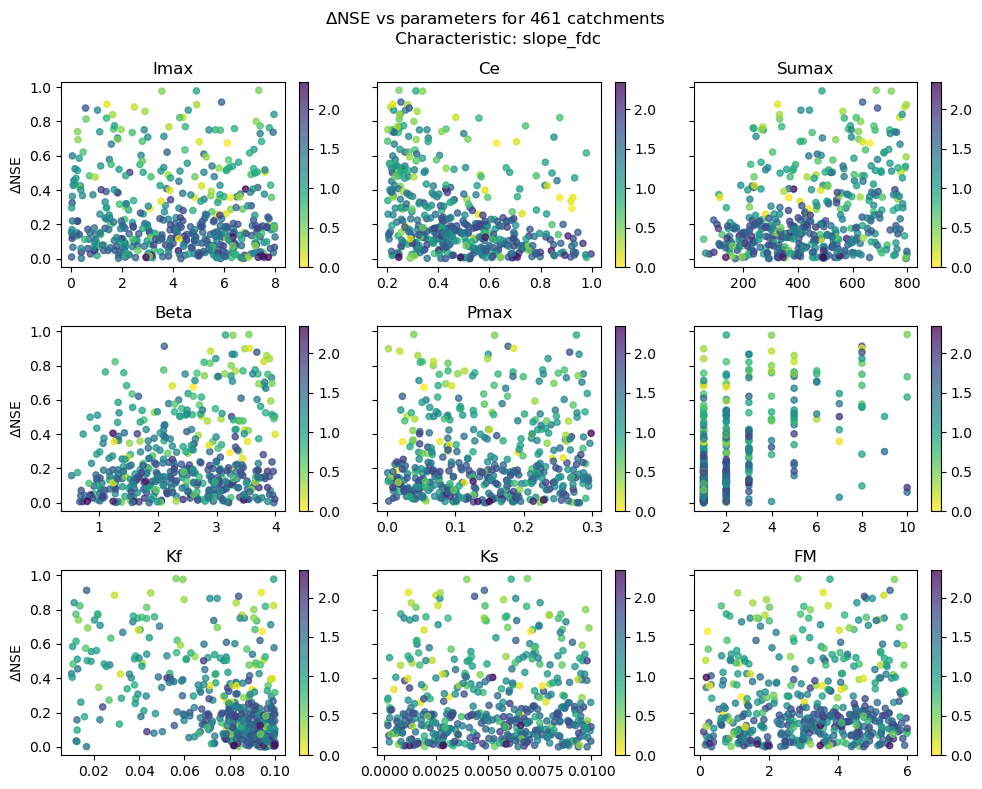

...

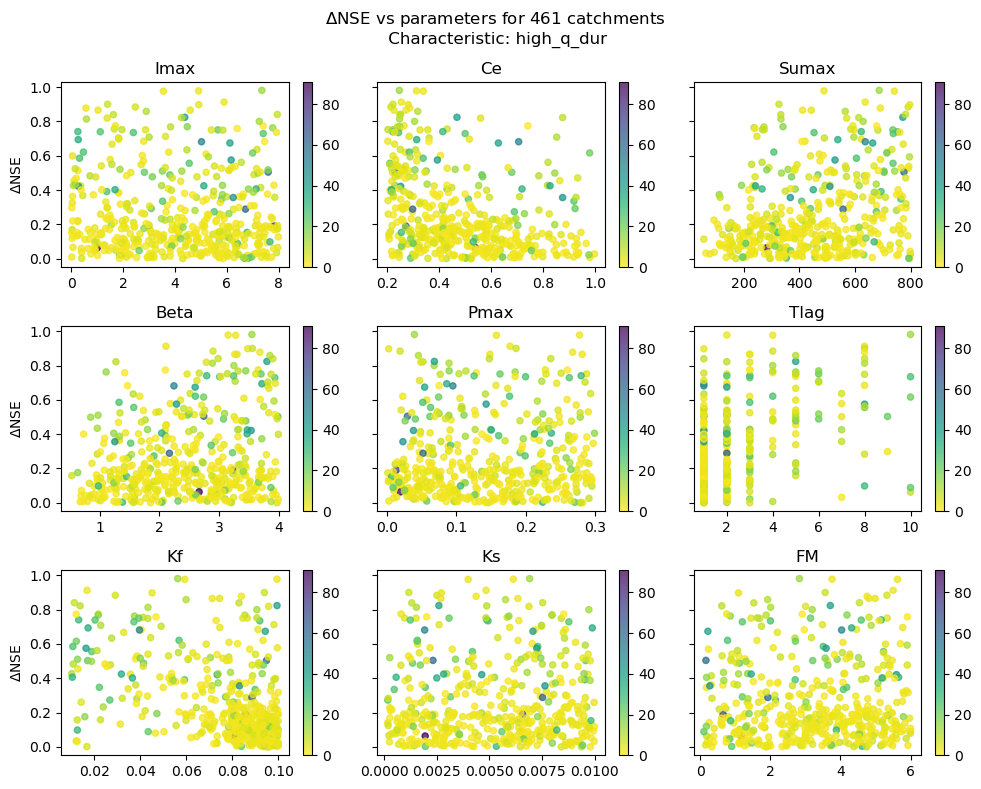

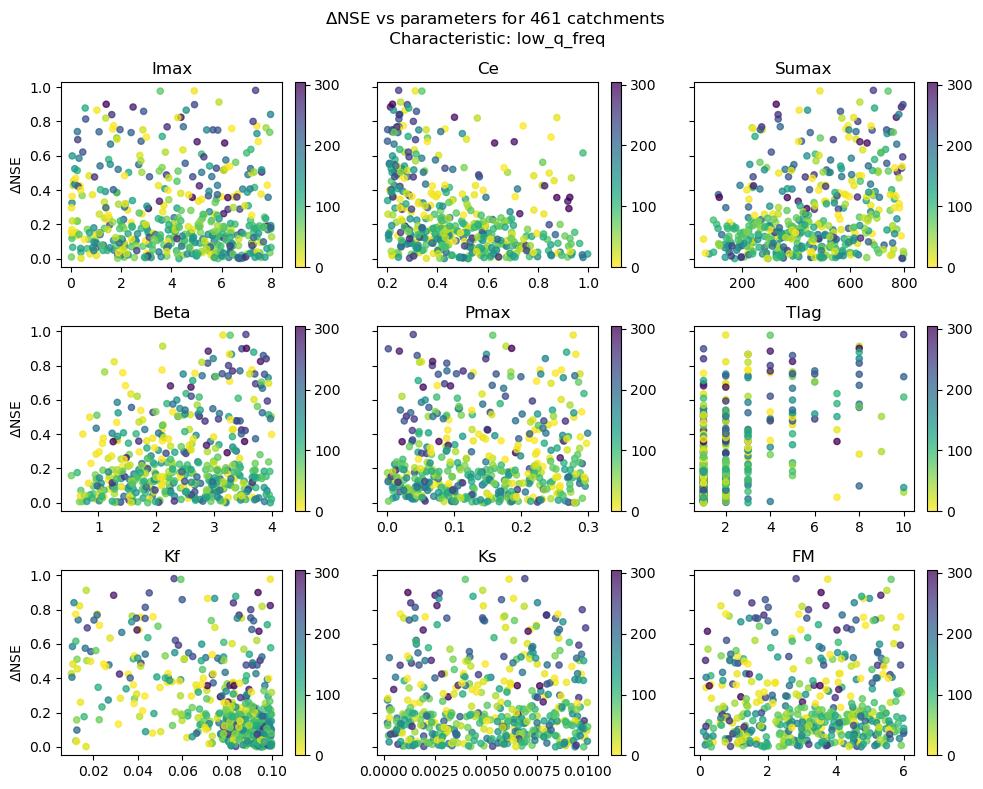

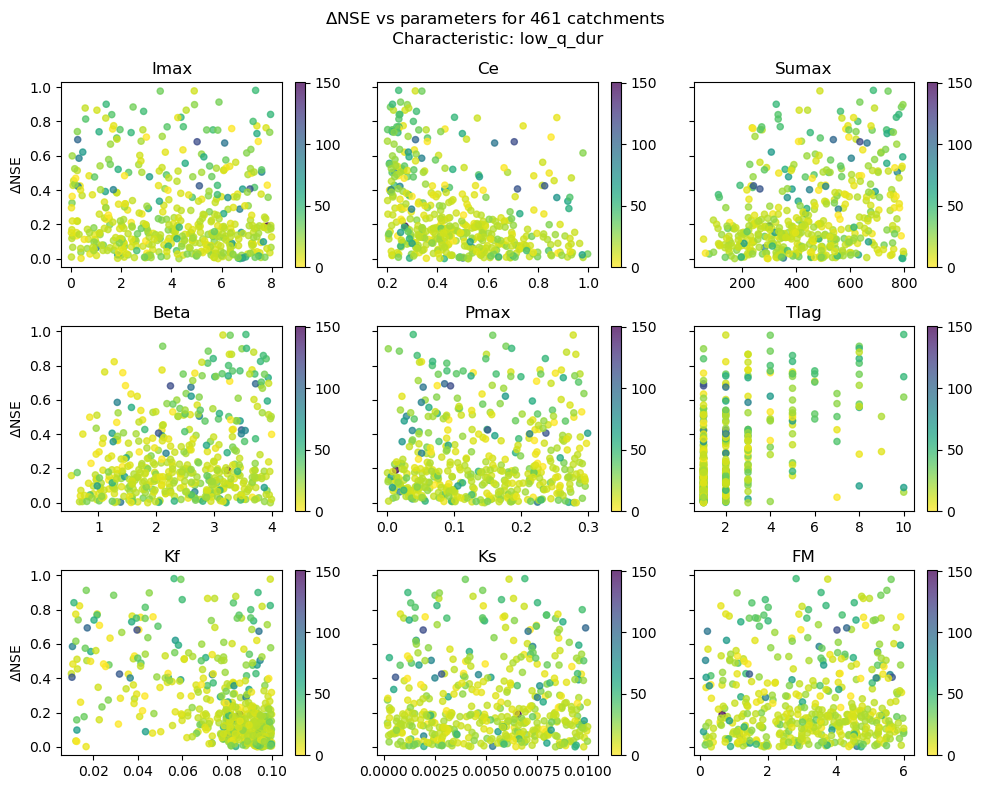

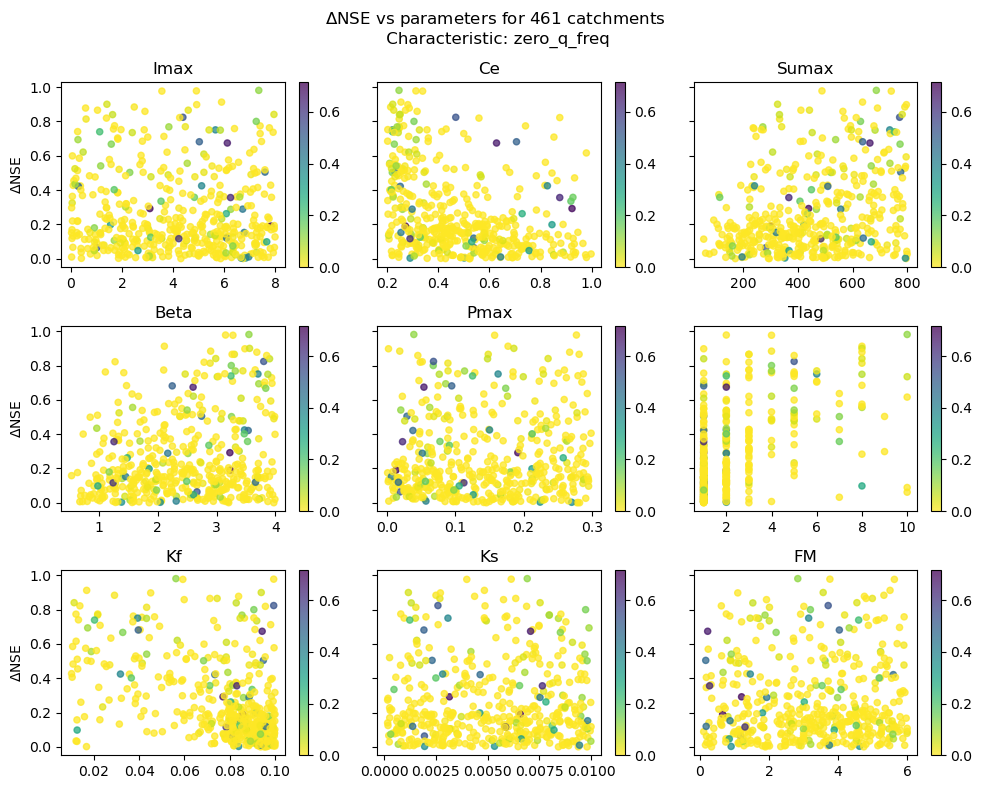

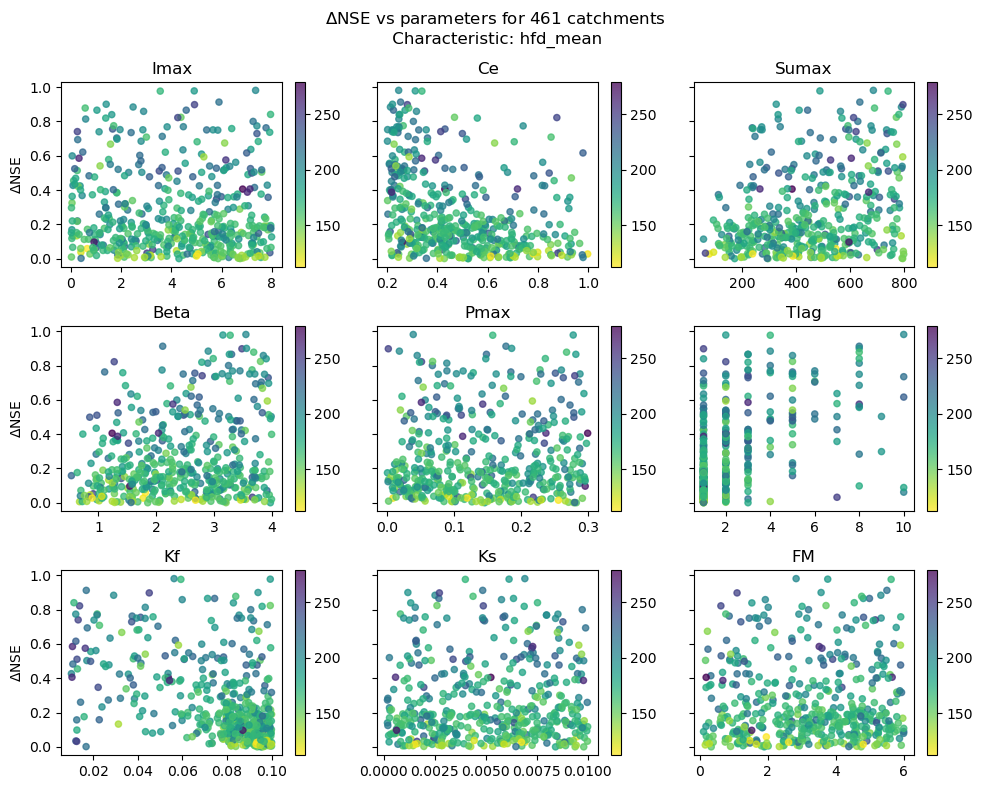

In [76]:
plot_all('hydro', 'NSE_delta_best', lst_results_char, dict_names_list)

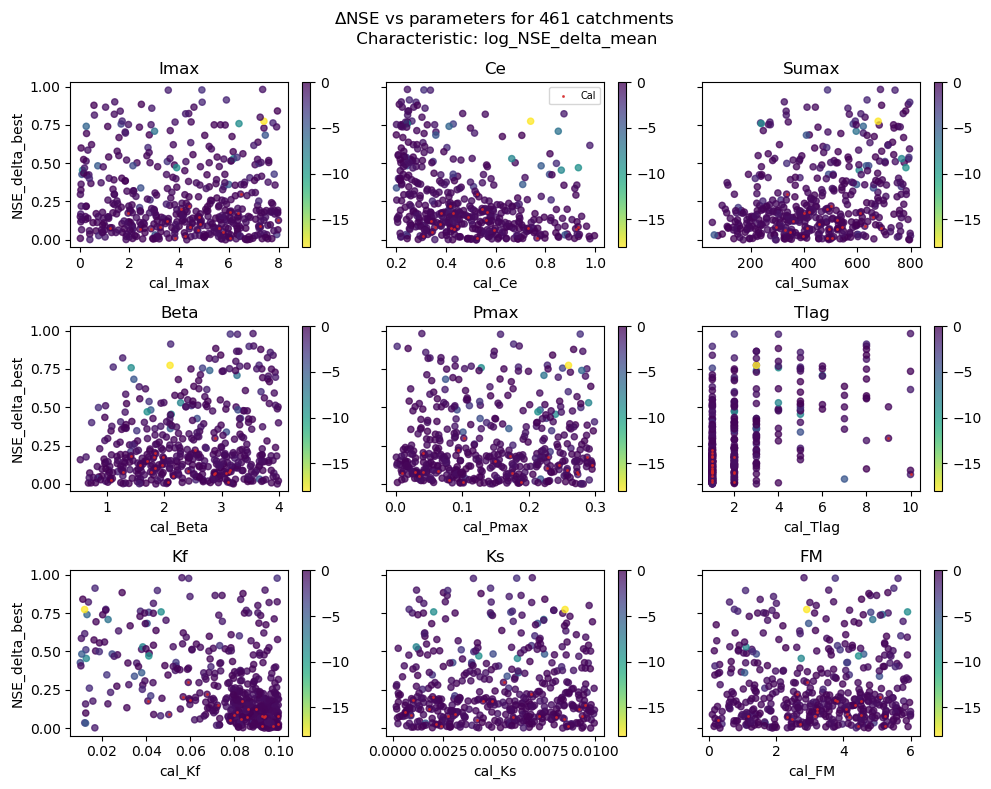

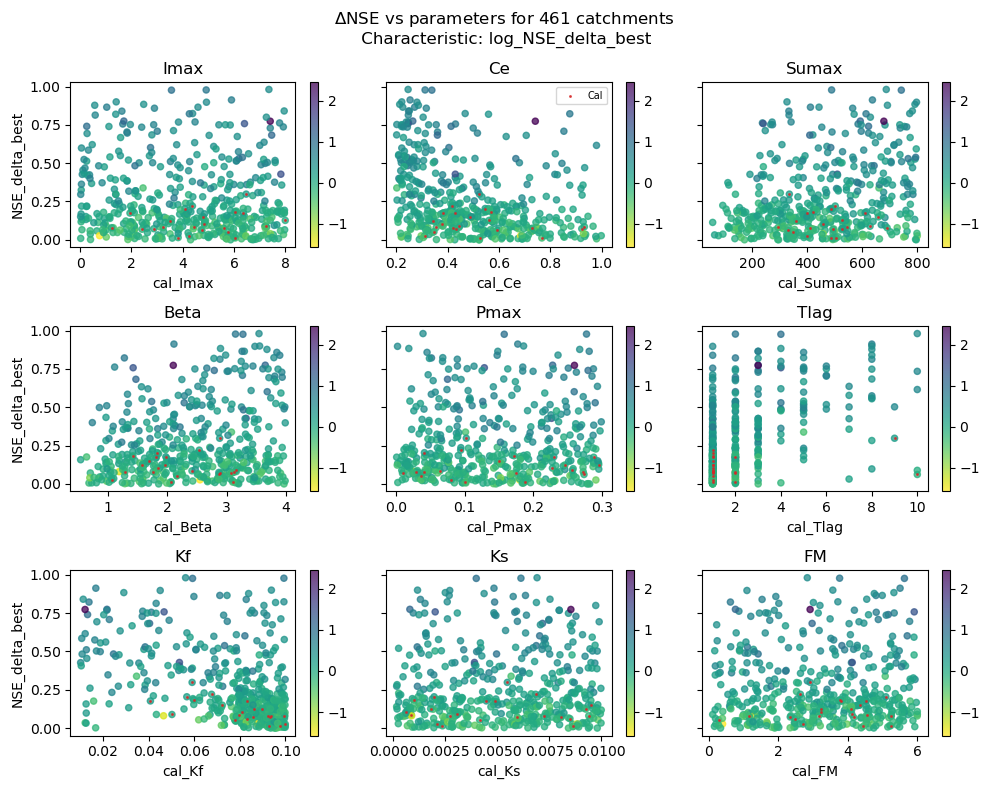

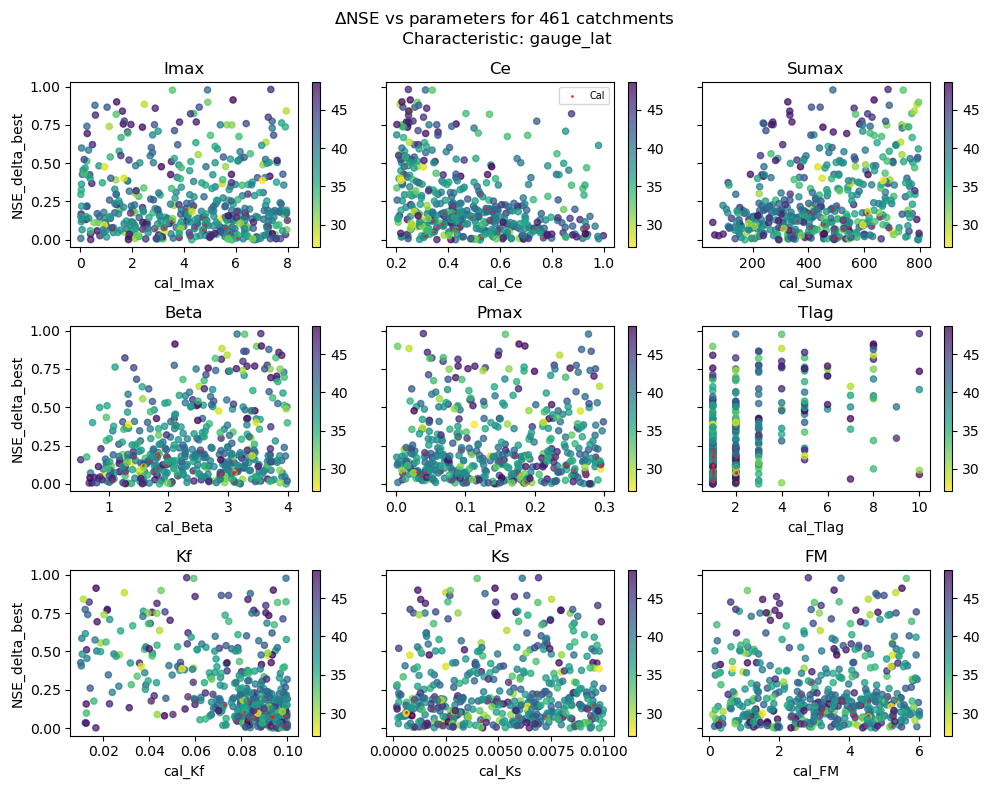

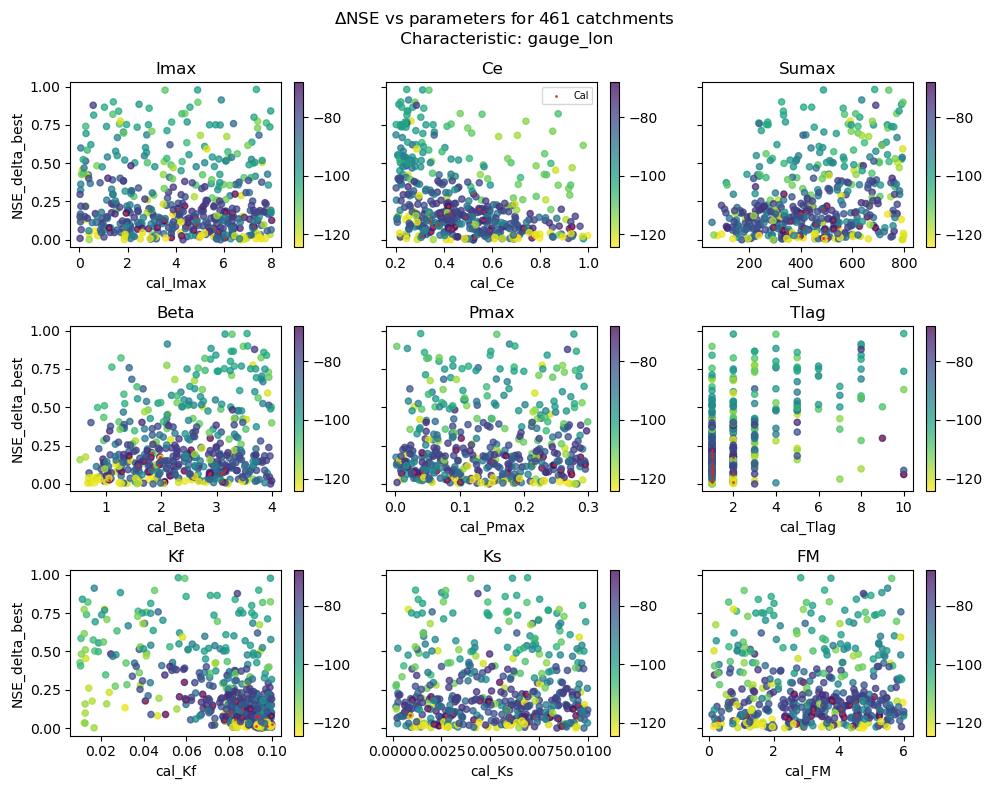

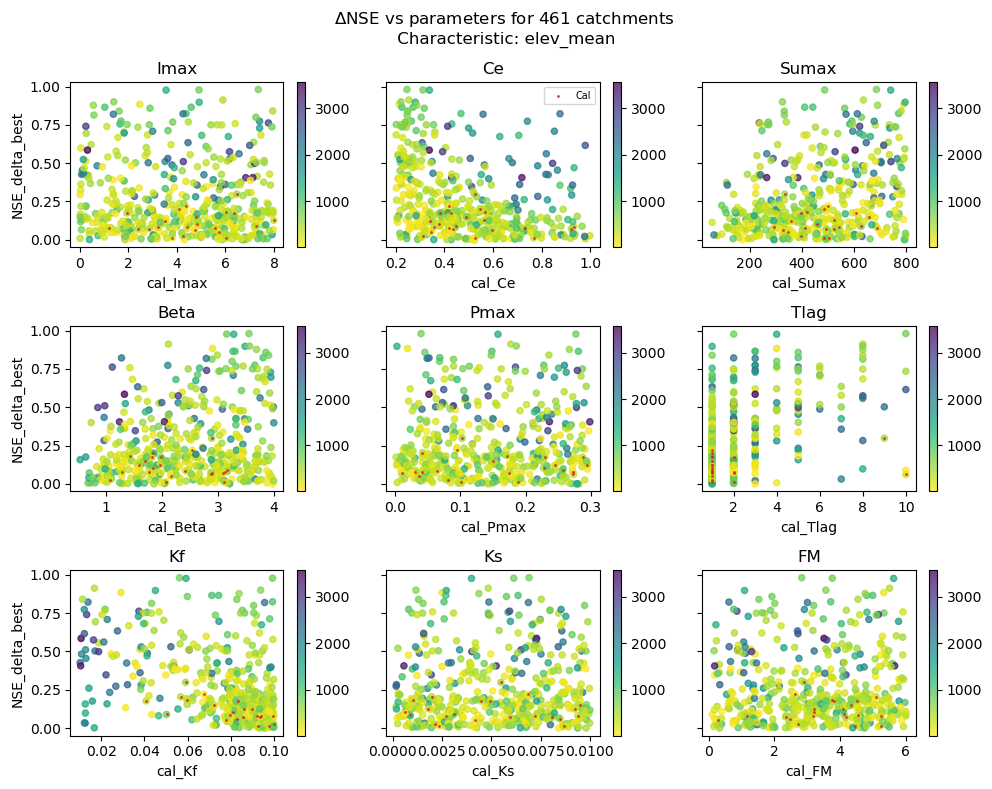

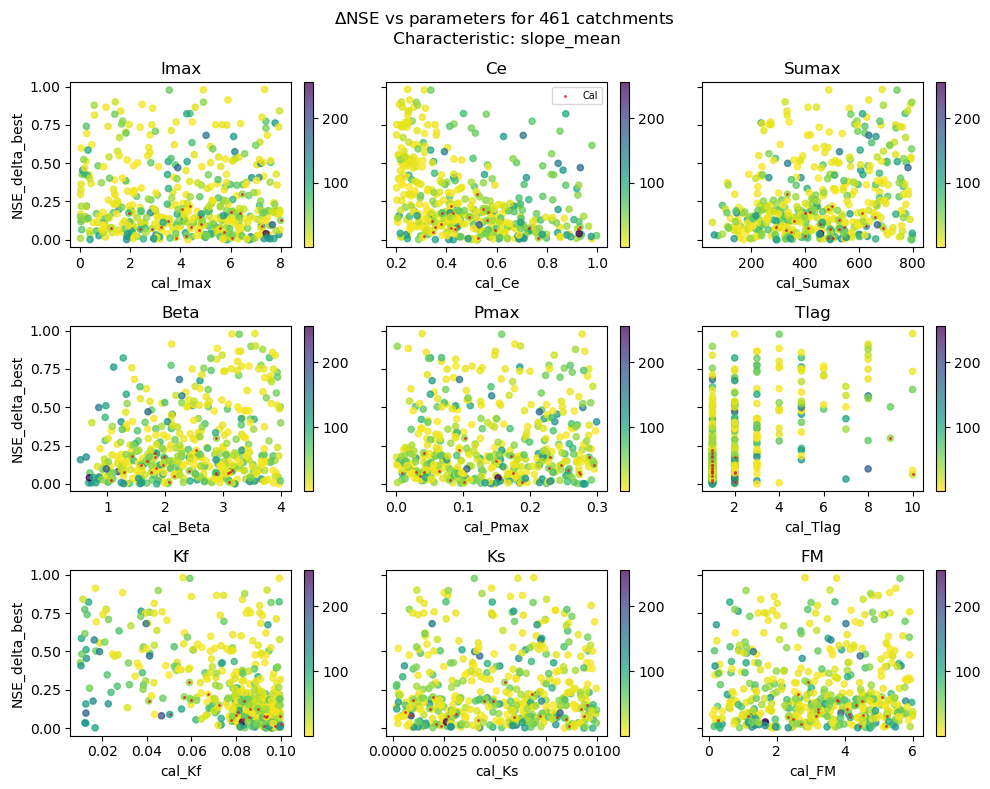

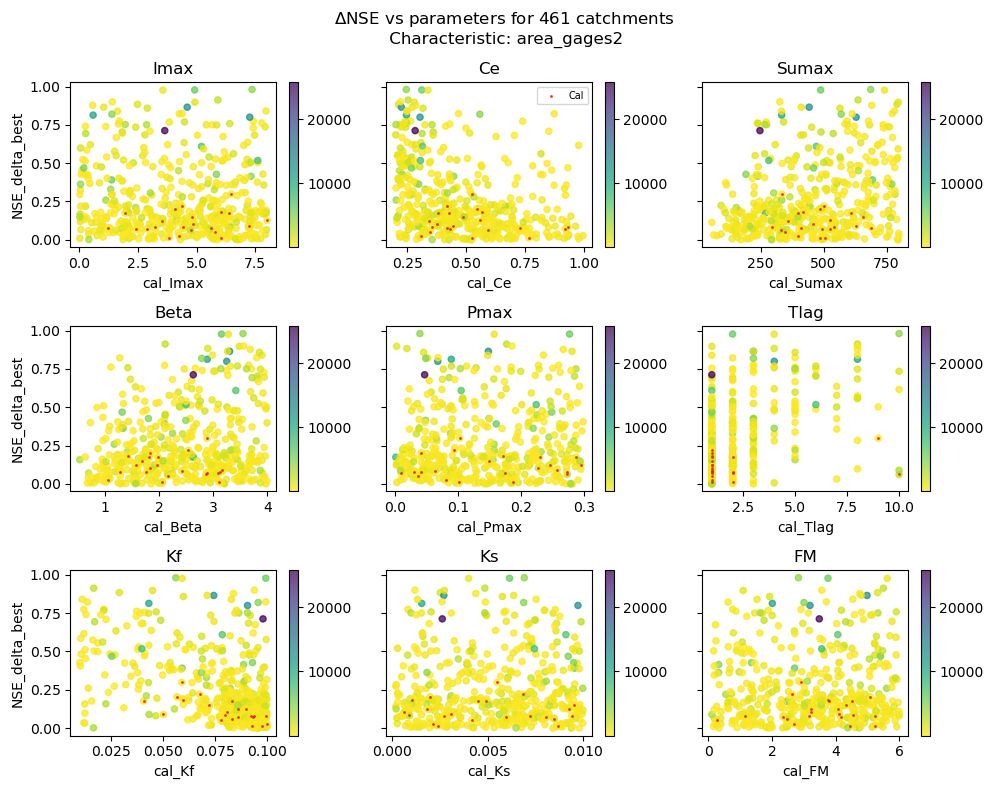

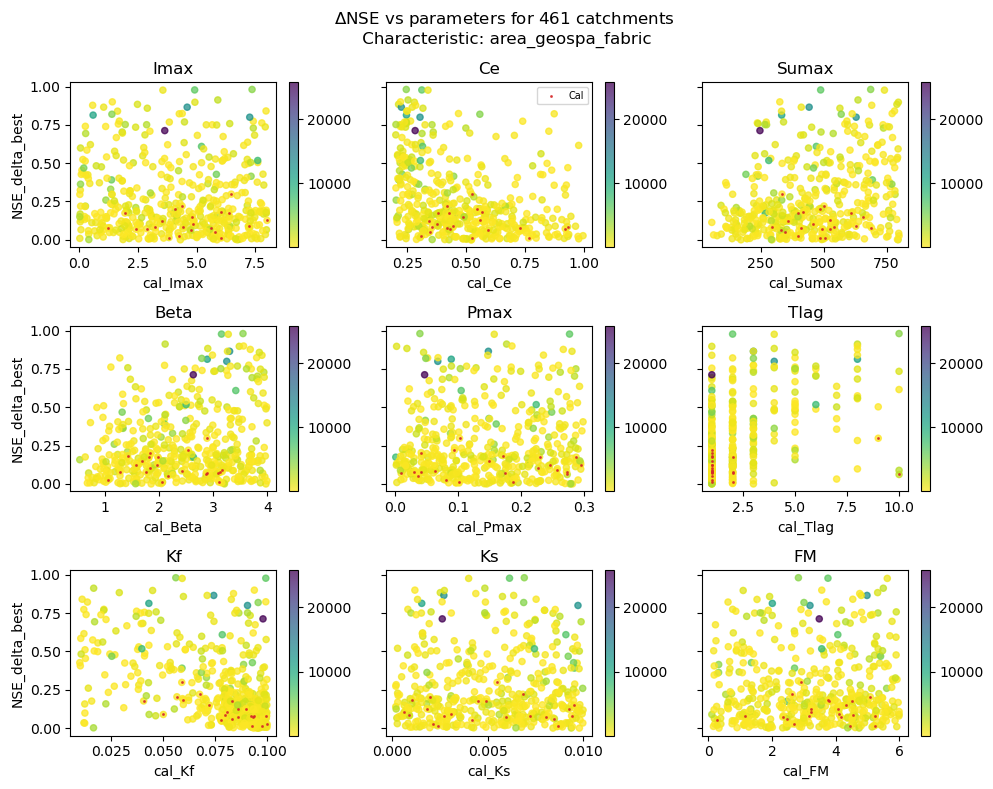

In [77]:
plot_all('topo', 'NSE_delta_best', lst_results_char, dict_names_list, show_cal=True, save=False)

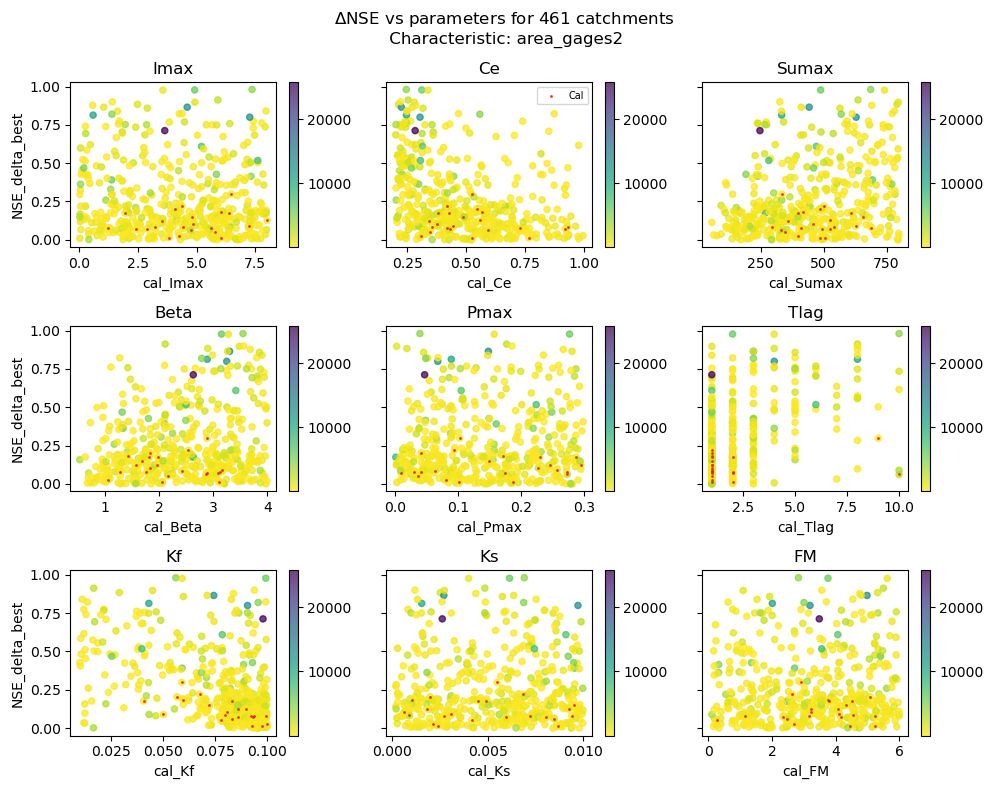

In [78]:
plot_yvar('NSE_delta_best', 'area_gages2', lst_results_char[dict_names_list['topo']], show_cal=True, save=False)

In [79]:
# plot_all('vege', 'NSE_delta_mean', lst_results_char, dict_names_list)

## save a few

In [80]:
def plot_yvar_3(y_var, c_var, df, show_cal=False, save=False):
    n = 9
    fig, axs = plt.subplots(1,3,figsize=(9,3),sharey=True)
    axs = axs.flatten()

    df_plot = df[df[y_var] > 0]
    fig.suptitle(f'$\Delta$NSE vs parameters for {len(df_plot)} catchments\n Characteristic: {c_var}')
    hru_id_cal_in_results = list(set(df_plot.index).intersection(hru_id_cal))
    df_cal = df_plot.loc[hru_id_cal_in_results]
    
    for i, param in enumerate(["Ce","Sumax","Beta"]):
        ax = axs[i]
        df_plot.plot.scatter(f'cal_{param}',y_var,c=df_plot[c_var].values, ax=ax,    colormap='viridis_r',alpha=0.75)
        ax.set_xlabel("")
        ax.set_ylabel("$\Delta$NSE")
        ax.set_title(param)
        # ax.set_ylim(-0.05, 1.03)

        if show_cal:
            df_cal.plot.scatter(f'cal_{param}',y_var, ax=ax,alpha=0.75, zorder=10, label='Cal',marker='.',s=5,color="C3")
            if i == 1:
                ax.legend(fontsize="x-small")
            else:
                ax.get_legend().remove()
        
    fig.tight_layout()
    if save: 
        fig.savefig(figure_path / f'parameters_vs_{y_var}_{c_var}.png',bbox_inches='tight',dpi=150)

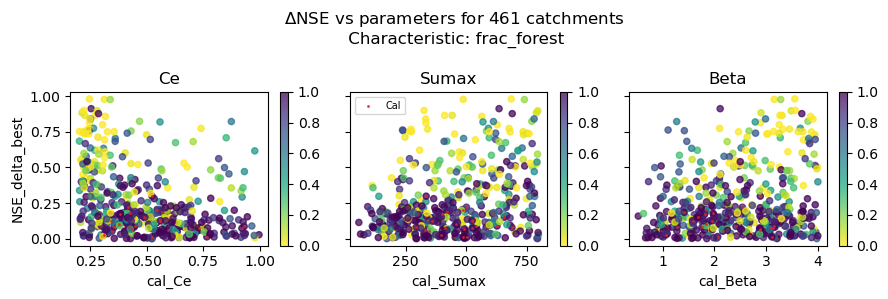

In [81]:
plot_yvar_3('NSE_delta_best', 'frac_forest', lst_results_char[dict_names_list['vege']], show_cal=True, save=False)

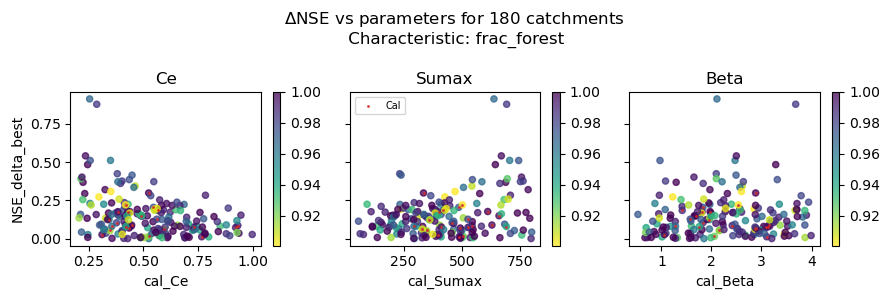

In [82]:
df_selection_forest_frac = lst_results_char[dict_names_list['vege']]
df_selection_forest_frac = df_selection_forest_frac[df_selection_forest_frac['frac_forest'] > 0.9]
plot_yvar_3('NSE_delta_best', 'frac_forest',df_selection_forest_frac, show_cal=True, save=False)

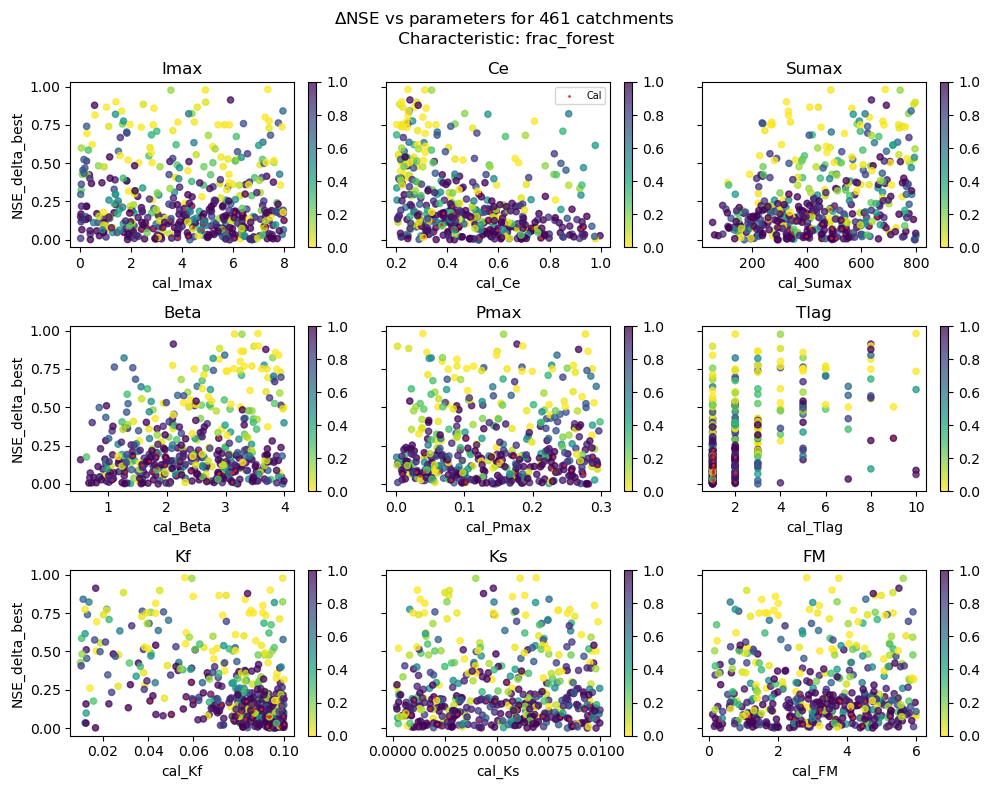

In [83]:
plot_yvar('NSE_delta_best', 'frac_forest', lst_results_char[dict_names_list['vege']], show_cal=True, save=False)

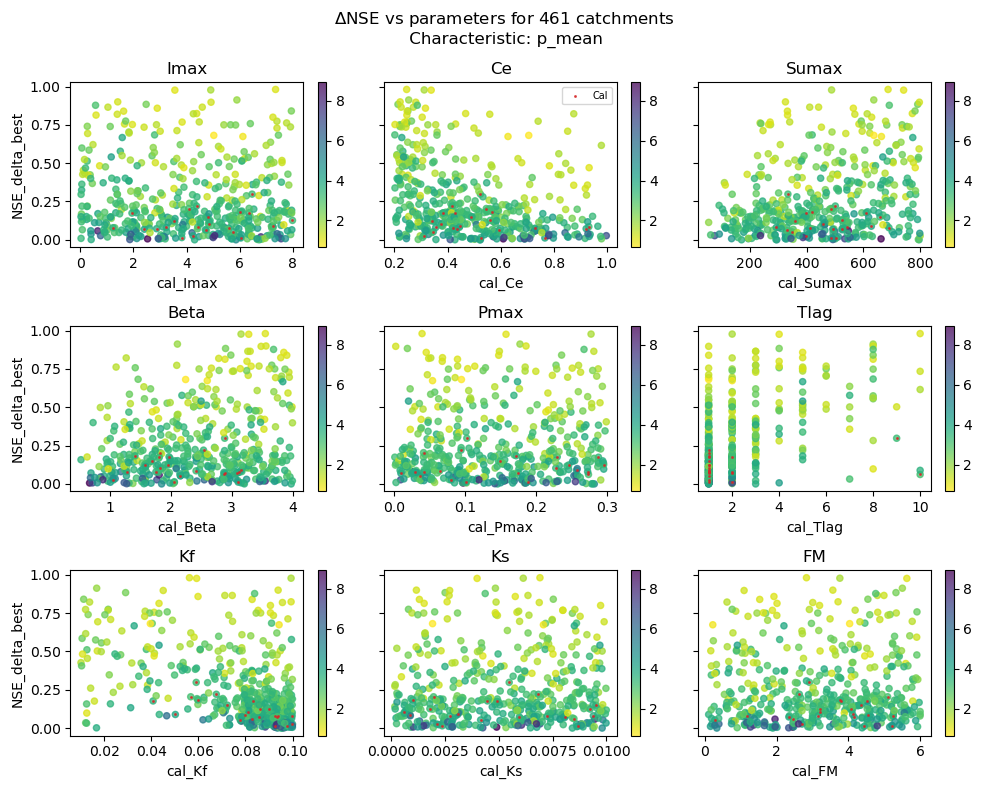

In [84]:
plot_yvar('NSE_delta_best', 'p_mean', lst_results_char[dict_names_list['clim']], show_cal=True, save=False)

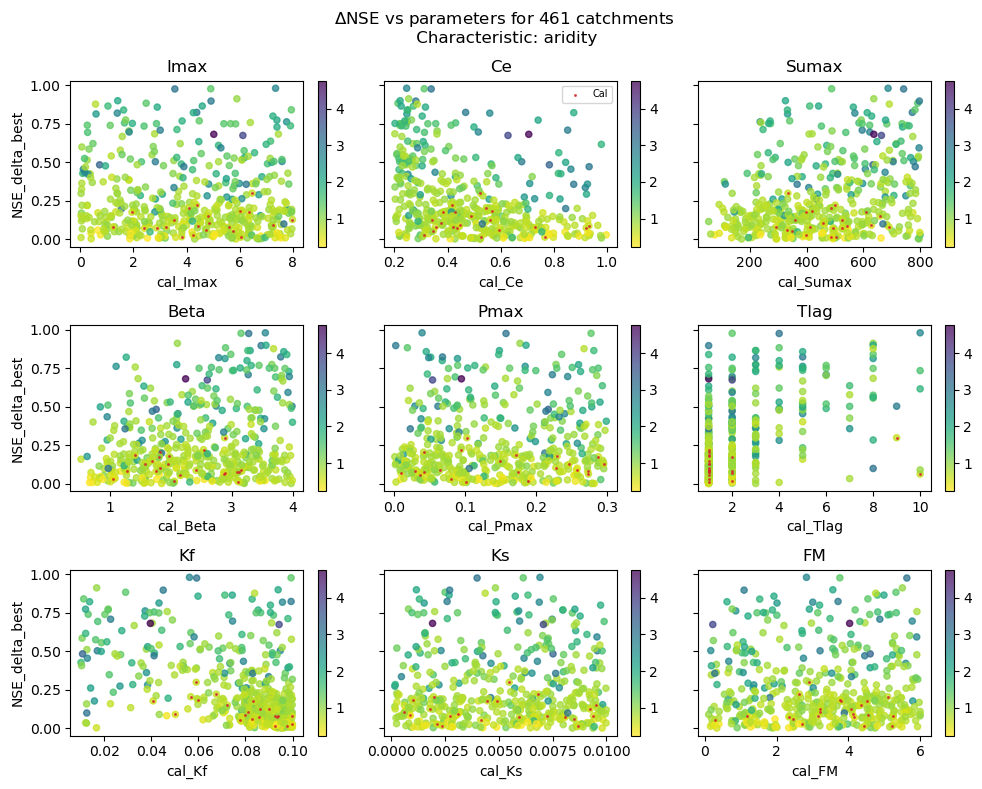

In [85]:
plot_yvar('NSE_delta_best', 'aridity', lst_results_char[dict_names_list['clim']], show_cal=True, save=False)

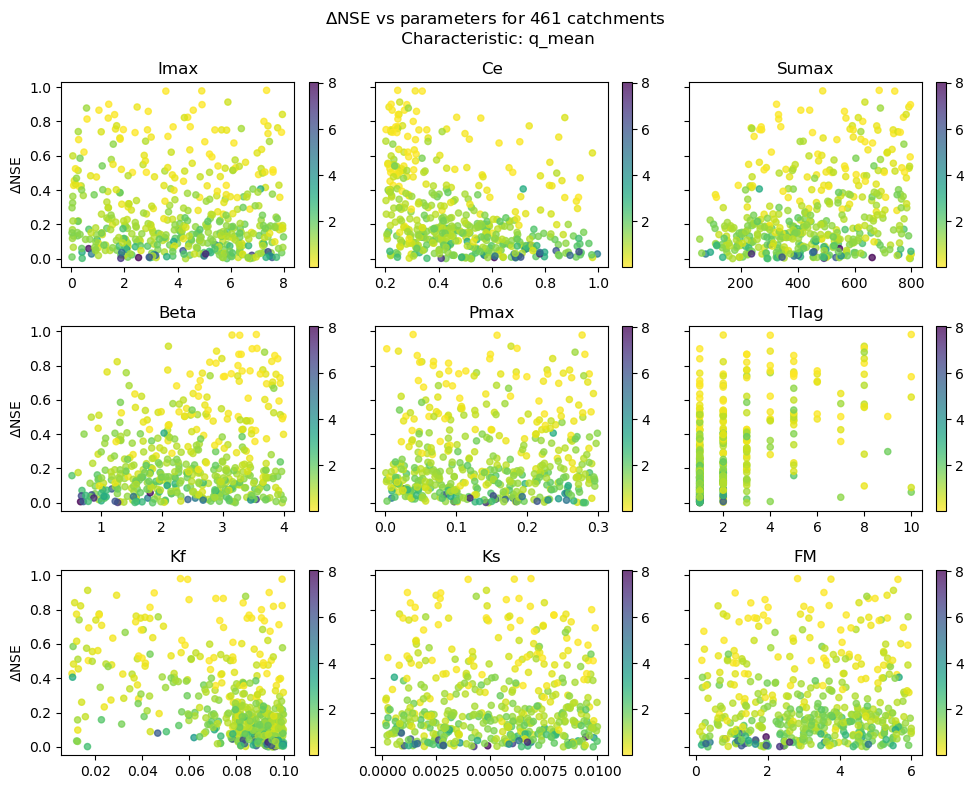

In [86]:
plot_yvar('NSE_delta_best', 'q_mean', lst_results_char[dict_names_list['hydro']], show_cal=False, save=False)

In [87]:
def plot_call_vs_da_dom_land_cov(df, c_var, custom_color_list, show_cal=False):
    fig, ax = plt.subplots(1,1,figsize=(5,4))

    unique_vals = sorted(df[c_var].unique())
    dict_cmap = dict(zip(unique_vals, custom_color_list))
    for val in unique_vals:
        df_plot = df[df[c_var] == val].copy()
        df_plot.plot.scatter('NSE_cal','NSE_best_DA',c=dict_cmap[val], ax=ax,alpha=0.75,label=val)

    ax.set_xlabel("NSE from calibration")
    ax.set_ylabel("NSE of best ensemble member from DA")
    ax.set_xlim(0,1)
    ax.set_ylim(0,1)
    ax.plot([[0,0],[1,1]],color="k",ls="--")
    ax.legend(bbox_to_anchor=(1,1))
    ax.set_title(f'NSE of calibration vs NSE of data assimilation\nCharacteristic: {c_var}')
    # ax.set_aspect('equal')

    if show_cal:
        hru_id_cal_in_results = list(set(df.index).intersection(hru_id_cal))
        df_cal = df.loc[hru_id_cal_in_results]
        df_cal.plot.scatter('NSE_cal','NSE_best_DA', ax=ax, zorder=10, label='Cal',s=5, color='C3',marker='.')
    
    return fig

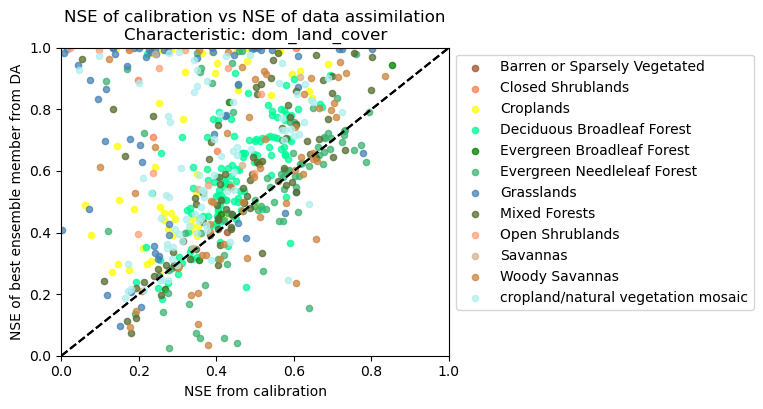

In [88]:
custom_color_list = ["sienna","coral","yellow","mediumspringgreen","green",
                                            "mediumseagreen","steelblue","darkolivegreen","lightsalmon","tan",
                                            "peru","paleturquoise"]
fig = plot_call_vs_da_dom_land_cov(lst_results_char[dict_names_list['vege']],'dom_land_cover', custom_color_list)
# fig.savefig(figure_path / 'dom_land_cover_comparison_nse.png',bbox_inches='tight',dpi=150)

In [ ]:
custom_color_list = ["sienna","coral","yellow","green","green",
                                            "green","steelblue","green","lightsalmon","tan",
                                            "peru","paleturquoise"]
fig = plot_call_vs_da_dom_land_cov(lst_results_char[dict_names_list['vege']],'dom_land_cover', custom_color_list)
fig.savefig(figure_path / 'dom_land_cover_forests_comparison_nse.png',bbox_inches='tight',dpi=150)

In [ ]:
def plot_call_vs_da(df,c_var, show_cal=False):
    fig, ax = plt.subplots(1,1,figsize=(6,4))
    df.plot.scatter('NSE_cal','NSE_best_DA',c=df[c_var].values,ax=ax,colormap='viridis_r',alpha=0.75)
    ax.set_xlabel("NSE from calibration")
    ax.set_ylabel("NSE of best ensemble member from DA")
    ax.set_xlim(0,1)
    ax.set_ylim(0,1)
    ax.plot([[0,0],[1,1]],color="k",ls="--")
    # ax.legend()
    ax.set_title(f'NSE of calibration vs NSE of data assimilation\nCharacteristic: {c_var}')

    if show_cal:
        hru_id_cal_in_results = list(set(df.index).intersection(hru_id_cal))
        df_cal = df.loc[hru_id_cal_in_results]
        df_cal.plot.scatter('NSE_cal','NSE_best_DA', ax=ax, zorder=10, label='Cal',s=5, color='C3',marker='.')
    return fig

# fig.savefig(figure_path / 'NSE_comparison.png',bbox_inches='tight',dpi=150)

In [ ]:
fig = plot_call_vs_da(lst_results_char[dict_names_list['clim']],'aridity')

In [ ]:
df_plot_qmean = lst_results_char[dict_names_list['hydro']].copy()
fig = plot_call_vs_da(df_plot_qmean,'q_mean',True)
# fig.savefig(figure_path / 'q_mean_comparison_nse.png',bbox_inches='tight',dpi=150)

In [ ]:
df_plot_qmean = df_plot_qmean[df_plot_qmean['q_mean']>1]
fig = plot_call_vs_da(df_plot_qmean,'q_mean',True)
# fig.savefig(figure_path / 'q_mean_comparison_nse.png',bbox_inches='tight',dpi=150)

In [ ]:
df_plot_qmean.sort_values('NSE_cal',ascending=False ).head(30)

In [ ]:
fig = plot_call_vs_da(lst_results_char[dict_names_list['vege']],'frac_forest',True)